In [1]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import glob as glob
import datetime as dt

import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.io import shapereader
import cartopy.io.img_tiles as cimgt

from sklearn.linear_model import QuantileRegressor
import sklearn

## Creating/load dataset

##### Load in the raw dataset

In [2]:
# Loading Data
ddict_list = glob.glob("/data/cristi/a/kchoo3/ERA5/reanalysis/hourly_1940-now/tmp_era5_*.nc")


ddict = []
for ds in ddict_list:
    ds = xr.open_dataset(ds)
    ddict.append(ds)
full_ds = xr.concat(ddict, dim='valid_time')

##### Calculate the Daily max temperature from raw dataset
Run all the cells chronologically

In [3]:
# This function calculate webulb temperature. It asks for temperature in celcius, and relative humidity in %
def Wetbulb(tmp, rh):
    wetbulb_tmp = ( tmp * np.arctan(0.151977 * (rh + 8.313659)**(1/2)) ) + np.arctan(tmp + rh) - np.arctan(rh - 1.676331) + (0.00391838 * ((rh)**(3/2))) * np.arctan(0.023101 * rh) - 4.686035
    return wetbulb_tmp

# source: https://journals.ametsoc.org/view/journals/apme/50/11/jamc-d-11-0143.1.xml
# def Wetbulb(tmp, rh):
#     # tmp in celcius
#     # rh in percent
#     wetbulb_tmp = ( tmp * np.arctan( (0.151977*(rh+8.313659))**(1/2) ) ) + np.arctan(tmp+rh) - np.arctan(rh - 1.676331) + ( ( 0.00391838*( rh**(3/2) ) ) * np.arctan(0.023101*rh)) - 4.686035
#     return wetbulb_tmp

# This function calculate NOAA's Heat Index.
def legacy_Heat_Index(T, RH):
    index = -42.379 + (2.04901523*T) + (10.14333127*RH) - (0.22475541*T*RH) - (0.00683783*T*T) - (0.05481717*RH*RH) + (0.00122874*T*T*RH) + (0.00085282*T*RH*RH) - (0.00000199*T*T*RH*RH)
    return index

In [4]:
def Heat_Index(T, RH):
    """
    https://www.wpc.ncep.noaa.gov/html/heatindex_equation.shtml

    Calculates heat index for an array
    
    Inputs:
        RH (DataArray) - Should be in decimal format
        T  (DataArray) - Should be in Kelvins
        
    Outputs:
        hi_alone (DataArray) - Heat index array (in F)
    """
    # Convert to Fahrenheit
    T_F = ((T - 273.15) * 1.8) + 32

    # Convert to relative humidity
    RH_p = RH * 100
    RH_p = RH_p.rename('relative_humidity')
    
    # Standard heat index
    heat_index = 0.5 * (T_F + 61.0 + ((T_F-68.0)*1.2) + (RH_p*0.094))
    heat_index = heat_index.rename('heat_index')

    # Combining temperature, relative humidity, and heat index into a dataset
    hi_set = xr.combine_by_coords((heat_index,T_F,RH_p))
        
    # Heat index for heat index above 80
    heat_index_80 = (-42.379 + 2.04901523*T_F + 10.14333127*RH_p - 0.22475541*T_F*RH_p 
          - 6.83783e-3*T_F**2 - 5.481717e-2*RH_p**2 + 1.22874e-3*T_F**2*RH_p 
          + 8.5282e-4*T_F*RH_p**2 - 1.99e-6*T_F**2*RH_p**2)
    hi_set['heat_index>80'] = heat_index_80
    
    # Replacing heat indices above 80 with the new equation
    hi_set['heat_index'] = xr.where(hi_set['heat_index']>80,
                                    hi_set['heat_index>80'],
                                    hi_set['heat_index']
                                    )
    
    # Heat index for relative humidity under 13% and temps between 80 and 112 F
    heat_index_13 = heat_index_80 - ((13-RH_p)/4) * np.sqrt((17 - abs(T_F - 95))/17)
    hi_set['heat_index_RH<13'] = heat_index_13
    
    hi_set['heat_index'] = xr.where(((hi_set['relative_humidity']<13) & 
                                         (hi_set['t2m']>80) & 
                                         (hi_set['t2m']<112)),
                                    hi_set['heat_index_RH<13'],
                                    hi_set['heat_index'])
    
    # Heat index for relative humidity over 85% and temps between 80 and 87 F
    heat_index_85 = heat_index_80 + ((RH_p-85)/10) * ((87-T_F)/5)
    hi_set['heat_index_RH>85'] = heat_index_85
    hi_set['heat_index'] = xr.where(((hi_set['relative_humidity']>85) & 
                                         (hi_set['t2m']>80) & 
                                         (hi_set['t2m']<87)),
                                    hi_set['heat_index_RH>85'],
                                    hi_set['heat_index'])
    
    # Picking out the heat index dataarray alone
    hi_alone = hi_set['heat_index']

    return hi_alone

In [36]:
parameters = ['t2m_c', 'tmp_wb', 'heat_index']
names = ['surface temperature', 'wetbulb temperature', 'heat index']
location_names_short = ['Urbana', 'Chicago', 'Springfield', 'Farm_Genoa', 'Farm_Bement', 'Farm_Carbondale']



location_ds = full_ds

# Assigning variables
location_ds = location_ds.assign(t2m_c=location_ds.t2m-273.15) 
location_ds = location_ds.assign(d2m_c=location_ds.d2m-273.15) 

rh = (location_ds.d2m_c/location_ds.t2m_c) * 100
location_ds = location_ds.assign(tmp_wb=Wetbulb(location_ds.t2m_c,rh)) 

tmp_f = (location_ds.t2m_c * 9/5) + 32
location_ds = location_ds.assign(heat_index=Heat_Index(location_ds.t2m,rh / 100)) 

# # Clean the outliers for heat index (not needed anymore)
# data = location_ds.heat_index
# lower_bound, upper_bound = data.quantile([0.01, 0.99]) 
# cleaned_data = data.where((data >= lower_bound) & (data <= upper_bound), np.nan)

# Change heat index to celcius (Keep it in Farenheit)
# cleaned_data = (cleaned_data - 32) * 5/9
# location_ds = location_ds.assign(heat_index=cleaned_data)

# Make Daily highs
max_tmp = location_ds.t2m_c.groupby(location_ds.valid_time.dt.date).max()
max_wb  = location_ds.tmp_wb.groupby(location_ds.valid_time.dt.date).max()
max_hi  = location_ds.heat_index.groupby(location_ds.valid_time.dt.date).max()

/data/keeling/a/kchoo3/anaconda3/envs/myenv/lib/python3.12/site-packages/xarray/core/computation.py:825: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)


In [49]:
max_tmp.attrs['units'] = 'Kelvin'
max_tmp.attrs['description'] = 'Temperature in Kelvin'

max_wb.attrs['units'] = 'Celsius'
max_wb.attrs['description'] = 'Wet-bulb temperature in Celsius'

max_hi.attrs['units'] = 'Fahrenheit'
max_hi.attrs['description'] = 'NOAAs Heat index'


ds = xr.Dataset({
    't2m': max_tmp,
    'wb': max_wb,
    'hi': max_hi
}, attrs={
    'title': 'Combined Maximum Temperature Data',
    'summary': 'Dataset containing maximum daily of temperature, wet-bulb temperature, and heat index from 1940-2024 in June-July-August.'}
)
# ds.to_netcdf('daily_max.nc')
ds['date'] = np.array(ds['date'].values, dtype='datetime64[ns]')

ds.to_netcdf('daily_max.nc')

##### Load dataset

In [4]:
daily_ds = xr.open_dataset('/data/cristi/a/kchoo3/projects/heat-stress/daily_max.nc')
daily_ds

<xarray.Dataset> Size: 56MB
Dimensions:    (latitude: 29, longitude: 21, date: 7636)
Coordinates:
    number     int64 8B ...
  * latitude   (latitude) float64 232B 43.0 42.75 42.5 42.25 ... 36.5 36.25 36.0
  * longitude  (longitude) float64 168B -92.0 -91.75 -91.5 ... -87.25 -87.0
  * date       (date) datetime64[ns] 61kB 1940-06-01 1940-06-02 ... 2024-08-31
Data variables:
    t2m        (date, latitude, longitude) float32 19MB ...
    wb         (date, latitude, longitude) float32 19MB ...
    hi         (date, latitude, longitude) float32 19MB ...
Attributes:
    title:    Combined Maximum Temperature Data
    summary:  Dataset containing maximum daily of temperature, wet-bulb tempe...

## Regression Creation

In [5]:
variable = 'hi'

def quantile_regression(y, X):
    """
    Use sklearn's QuantileRegressor to
    Returns an array with [slope, intercept].
    
    Parameters
    ----------
    y : array, shape (time,) values at one grid point.
    X : array, should be the date values
    """
    qr = QuantileRegressor(quantile=0.50, alpha=0)
    qr.fit(X, y)
    return np.array([qr.coef_[0], qr.intercept_])

ds = daily_ds
X = daily_ds.date.values[:, np.newaxis].astype('datetime64[D]').astype('int64')

result = xr.apply_ufunc(
    quantile_regression,
    ds[variable],  # the data variable to process
    input_core_dims=[["date"]],  
    kwargs={'X': X},  
    vectorize=True,
    output_core_dims=[["params"]],
    output_dtypes=[float]
)


KeyboardInterrupt



In [154]:
slope = result.sel(params=0)
intercept = result.sel(params=1)

slope.attrs['description'] = 'The beta values. The trend of the 50th linear regression'
intercept.attrs['description'] = 'The alpha values. The baseline 50qr temperature'

save_ds = xr.Dataset({
    'slope': slope,
    'intercept': intercept
}, attrs={
    'title': f'50th QuantileRegressor of {variable}',
    'summary': f'Dataset the slope and intersect of 50th QuantileRegressor of {variable}.'}
)
save_ds.to_netcdf('hi_overall_50qr.nc')

### Analysis

In [31]:
t2m_qr

<xarray.Dataset> Size: 10kB
Dimensions:    (latitude: 29, longitude: 21)
Coordinates:
    number     int64 8B 0
  * latitude   (latitude) float64 232B 43.0 42.75 42.5 42.25 ... 36.5 36.25 36.0
  * longitude  (longitude) float64 168B -92.0 -91.75 -91.5 ... -87.25 -87.0
Data variables:
    slope      (latitude, longitude) float64 5kB 2.447e-05 ... 1.496e-05
    intercept  (latitude, longitude) float64 5kB 26.52 26.52 ... 30.82 30.87
Attributes:
    title:    50th QuantileRegressor of t2m
    summary:  Dataset the slope and intersect of 50th QuantileRegressor of t2m.

In [4]:
t2m_qr = xr.open_dataset('/data/cristi/a/kchoo3/ERA5/reanalysis/hourly_1940-now/qr/95/tmp_overall_95qr.nc')
wb_qr = xr.open_dataset('/data/cristi/a/kchoo3/ERA5/reanalysis/hourly_1940-now/qr/95/wetbulb_overall_95qr.nc')
hi_qr = xr.open_dataset('/data/cristi/a/kchoo3/ERA5/reanalysis/hourly_1940-now/qr/95/hi_overall_95qr.nc')

0 = deg/day 1 = deg/decade


Enter your selection:  1


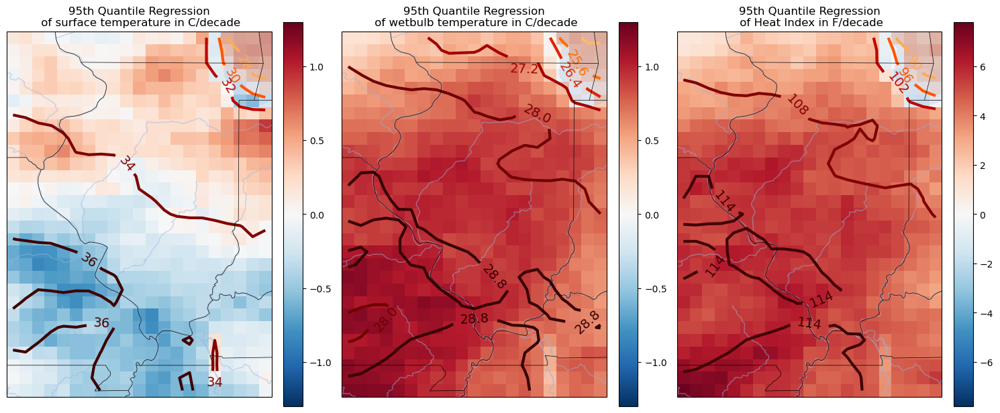

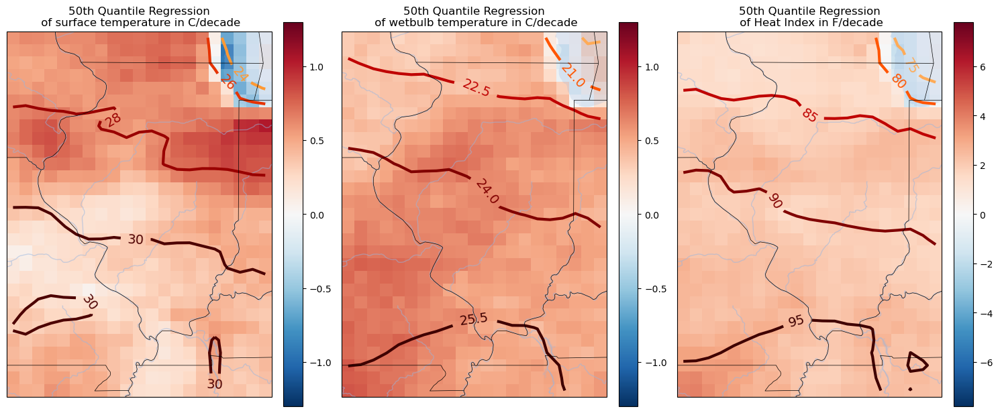

In [9]:
# Helper function to add common map features to an axis
def add_map_features(ax):
    ax.add_feature(cfeature.LAKES, alpha=0.25)  # Add lakes
    ax.add_feature(cfeature.RIVERS, alpha=0.5)   # Add rivers
    ax.add_feature(cfeature.BORDERS, linestyle=":")  # Add borders
    states_provinces = cfeature.NaturalEarthFeature(
        category='cultural',  
        name='admin_1_states_provinces_lines',
        scale='50m', 
        linewidth=0.5, 
        facecolor='none'
    )
    ax.add_feature(states_provinces, edgecolor='black', zorder=10)
    
# ==========================================================================
# ==========================================================================

quantiles = ['95','50']

print("0 = deg/day 1 = deg/decade") 
selection = input("Enter your selection: ")
selection = int(selection)

for q_ind, quantile in enumerate(quantiles):
    t2m_qr = xr.open_dataset(f'/data/cristi/a/kchoo3/ERA5/reanalysis/hourly_1940-now/qr/{quantile}/tmp_overall_{quantile}qr.nc')
    wb_qr = xr.open_dataset(f'/data/cristi/a/kchoo3/ERA5/reanalysis/hourly_1940-now/qr/{quantile}/wetbulb_overall_{quantile}qr.nc')
    hi_qr = xr.open_dataset(f'/data/cristi/a/kchoo3/ERA5/reanalysis/hourly_1940-now/qr/{quantile}/hi_overall_{quantile}qr.nc')
    
    if selection == 1:
        t2m_slope = t2m_qr.slope * ( 365.25 * 64 )
        wb_slope = wb_qr.slope * ( 365.25 * 64 )
        hi_slope = hi_qr.slope * ( 365.25 * 64 )
        unit = "/decade"
        s_min = -0.20*6.5
        s_max = 0.20*6.5
    else:
        t2m_slope = t2m_qr.slope
        wb_slope = wb_qr.slope
        hi_slope = hi_qr.slope
        unit = "/day"
        s_min = -0.00005
        s_max = 0.00005
    
    
    # Create a single figure with 3 side-by-side subplots
    fig, (ax1, ax2, ax3) = plt.subplots(ncols=3, figsize=(15, 7), dpi=100, subplot_kw=dict(projection=ccrs.PlateCarree()))
    
    # Add features to both axes
    add_map_features(ax1)
    add_map_features(ax2)
    add_map_features(ax3)
    
    # Temperature
    im1 = t2m_slope.plot(ax=ax1, add_colorbar=False, vmin=s_min, vmax=s_max, cmap='RdBu_r')
    cbar1 = fig.colorbar(im1, ax=ax1, orientation='vertical', fraction=0.065, pad=0.04)
    
    CS = t2m_qr.intercept.plot.contour(ax=ax1, cmap='gist_heat_r', linewidths=3)
    ax1.clabel(CS, fontsize=14)
    
    ax1.set_title(f"{quantile}th Quantile Regression\n of surface temperature in C{unit}")
    
    # Wetbulb
    im1 = wb_slope.plot(ax=ax2, add_colorbar=False, vmin=s_min, vmax=s_max, cmap='RdBu_r')
    cbar1 = fig.colorbar(im1, ax=ax2, orientation='vertical', fraction=0.065, pad=0.04)
    
    CS = wb_qr.intercept.plot.contour(ax=ax2, cmap='gist_heat_r', linewidths=3)
    ax2.clabel(CS, fontsize=14)
    
    ax2.set_title(f"{quantile}th Quantile Regression\n of wetbulb temperature in C{unit}")
    
    # Wetbulb
    im1 = hi_slope.plot(ax=ax3, add_colorbar=False, vmin=s_min*6, vmax=s_max*6, cmap='RdBu_r')
    cbar1 = fig.colorbar(im1, ax=ax3, orientation='vertical', fraction=0.065, pad=0.04)
    
    CS = hi_qr.intercept.plot.contour(ax=ax3, cmap='gist_heat_r', linewidths=3)
    ax3.clabel(CS, fontsize=14)
    
    ax3.set_title(f"{quantile}th Quantile Regression\n of Heat Index in F{unit}")
    
    plt.tight_layout()
    plt.show()


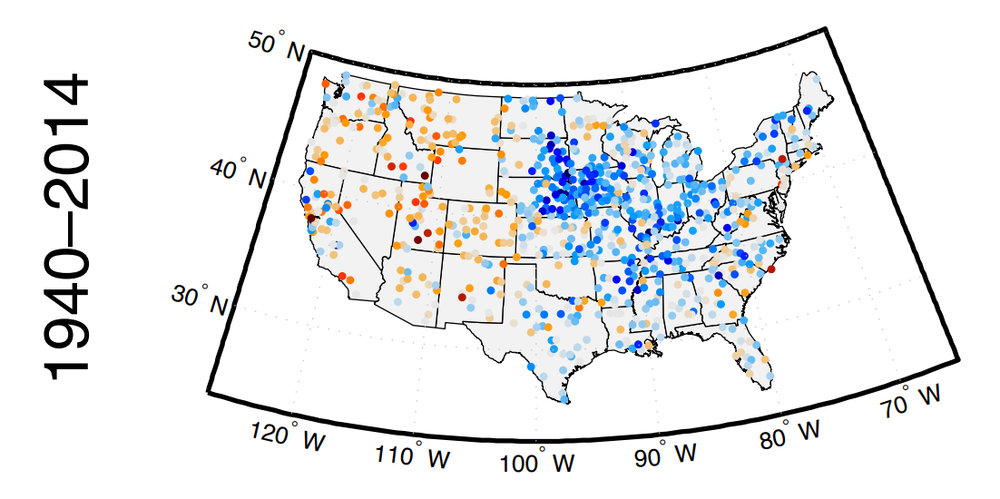

Figure above:           95th Quantile of observed surface temperature from 1940-2014, no exclusion
Data used in the paper: GHCND database
Source:                 Mueller et al. 2016


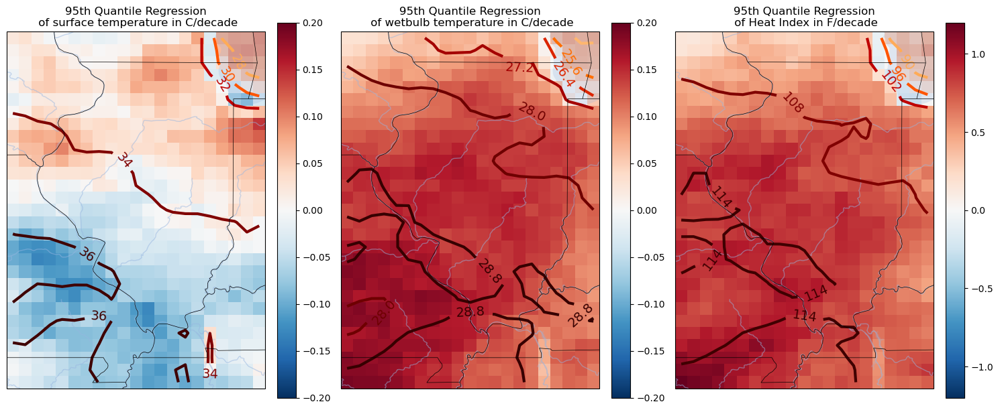

Figure above: 95th Quantile of various matric from 1940-2014, no exclusion
Data used:    ERA5 reanalysis data


In [11]:
from IPython.display import Image, display
image_path = "mueller16_1940-2014_all.png"
display(Image(filename=image_path, width=600))
print("Figure above:           95th Quantile of observed surface temperature from 1940-2014, no exclusion")
print("Data used in the paper: GHCND database")
print("Source:                 Mueller et al. 2016")


image_path = "95qr.png"
display(Image(filename=image_path))
print("Figure above: 95th Quantile of various matric from 1940-2014, no exclusion")
print("Data used:    ERA5 reanalysis data")

### Individual Map

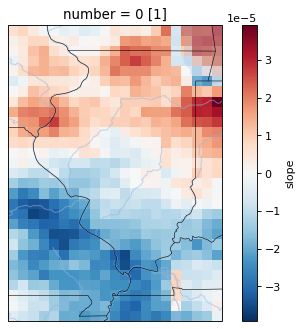

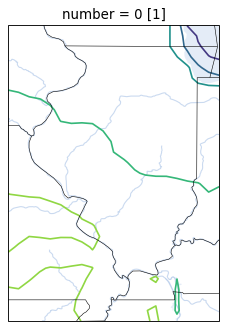

In [105]:
def create_map(projection=ccrs.PlateCarree()):
    fig, ax = plt.subplots(dpi=80, subplot_kw=dict(projection=projection))
    ax.add_feature(cfeature.LAKES, alpha=0.25)  # Add lakes
    ax.add_feature(cfeature.RIVERS, alpha=0.5)   # Add rivers
    ax.add_feature(cfeature.BORDERS, linestyle=":")  # Add borders
    states_provinces = cfeature.NaturalEarthFeature(
        category='cultural',  
        name='admin_1_states_provinces_lines',
        scale='50m', 
        linewidth=0.5, 
        facecolor='none'
    )
    ax.add_feature(states_provinces, edgecolor='black', zorder=10)
    return fig, ax

result = test_ds

# Plot for result.slope
fig1, ax1 = create_map()
result.slope.plot(ax=ax1)
plt.show()

# Plot for result.intercept
fig2, ax2 = create_map()
result.intercept.plot.contour(ax=ax2)
plt.show()

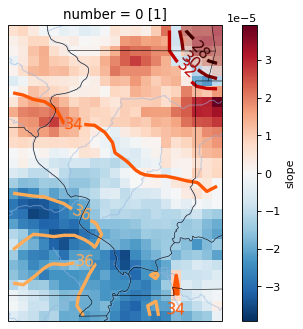

In [119]:
fig1, ax1 = create_map()
t2m_qr.slope.plot(ax=ax1)
CS = t2m_qr.intercept.plot.contour(ax=ax1, cmap='gist_heat', linewidths=3)
ax.clabel(CS, fontsize=14)
plt.show()

fig2, ax2 = create_map()
wb_qr.slope.plot(ax=ax2)
CS = wb_qr.intercept.plot.contour(ax=ax2, cmap='gist_heat', linewidths=3)
ax.clabel(CS, fontsize=14)
plt.show()

# Legacy Code, ignore everything below. I will clean them up soon

## Selecting location

#### 6 Locations in Illinois (or select one)

In [5]:
# Simply run this cell for selection
location_names = ['Urbana', 'Chicago', 'Springfield', 'Farmland Genoa', 'Bement', 'Farmland Carbondale (far north)']
location_ddict = [[40, -88.25], [41.75, -87.75], [39.75, -89.75], [42, -88.50], [40, -88.5], [38, -89.5]]

print("0 = Urbana 1 = Chicago 2 = Springfield") 
print("3 = Farmland Genoa 4 = Bement 5 = Farmland Carbondale (far north)")
print("type -1 for custom input")
selection = input("Enter your selection: ")
selection = int(selection)
if selection == -1:
    # Location
    print("Enter location name")
    name = input("Enter location name: ")
    location_name = name
    # Latitute
    print("Enter the coordinate (gridded every 0.25deg")
    lat = input("Enter the latitude: ")
    lon = input("Enter the longitude: ")
    location_ds = full_ds.sel(latitude=lat,longitude=lon)
elif selection < 6 and selection > -1:
    location_ds = full_ds.sel(latitude=location_ddict[selection][0],longitude=location_ddict[selection][1])
    location_name = location_names[selection]
else:
    print("invalid input")

0 = Urbana 1 = Chicago 2 = Springfield
3 = Farmland Genoa 4 = Bement 5 = Farmland Carbondale (far north)
type -1 for custom input


Enter your selection:  0


##### Showing where the grid points are

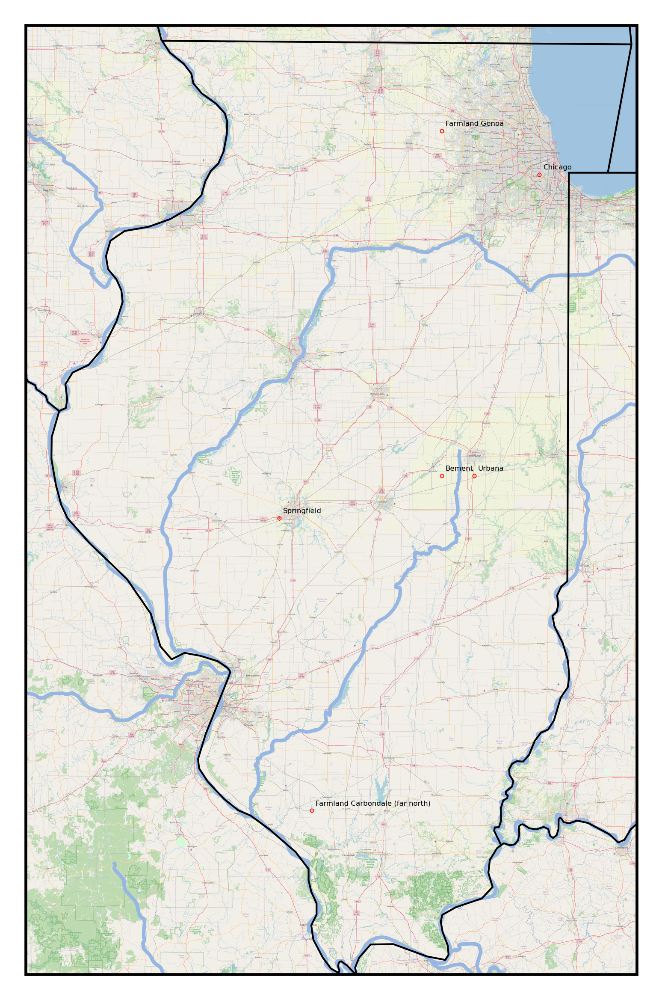

In [34]:
def make_map(projection=ccrs.PlateCarree()):
  fig, ax = plt.subplots(dpi=600,subplot_kw=dict(projection=projection))
  return fig, ax

extent = [-91.7, -87, 37, 42.6]

# request = cimgt.GoogleTiles(style='satellite')
request = cimgt.OSM()

fig, ax = make_map(projection=request.crs)
ax.set_extent(extent)

ax.add_image(request, 10, interpolation='spline36')

ax.add_feature(cfeature.LAKES, alpha =0.5) # Add lakes
ax.add_feature(cfeature.RIVERS) # Add rivers
ax.add_feature(cfeature.BORDERS, linestyle=":") # Add border
states_provinces = cfeature.NaturalEarthFeature(category='cultural',  name='admin_1_states_provinces_lines',
                                                scale='50m', linewidth=0.5, facecolor='none')
ax.add_feature(states_provinces, edgecolor='black', zorder=10)

for i in range(len(location_names)):
  ax.plot(location_ddict[i][1],location_ddict[i][0],color='red',marker='o', markersize=0.2,transform=ccrs.PlateCarree(), clip_on=True, zorder=20)
  ax.text(x=location_ddict[i][1]+0.03, y=location_ddict[i][0]+0.03,s=location_names[i],fontsize=2, c='black', clip_on=True, transform=ccrs.PlateCarree(), zorder=20)

#### Averaged Illinois

In [7]:
# 37, -91.5 to 42.75, -87.5

# select the box range
lat_range = np.arange(37, 42.8, step=0.25)
lon_range = np.arange(-91.5, -87.4, step=0.25)

#
ds = full_ds.sel(latitude=lat_range,longitude=lon_range)
location_name = "Illinois (average)"

# averaging
location_ds = ds.mean(dim=['latitude', 'longitude'])


##### Showing the box selected

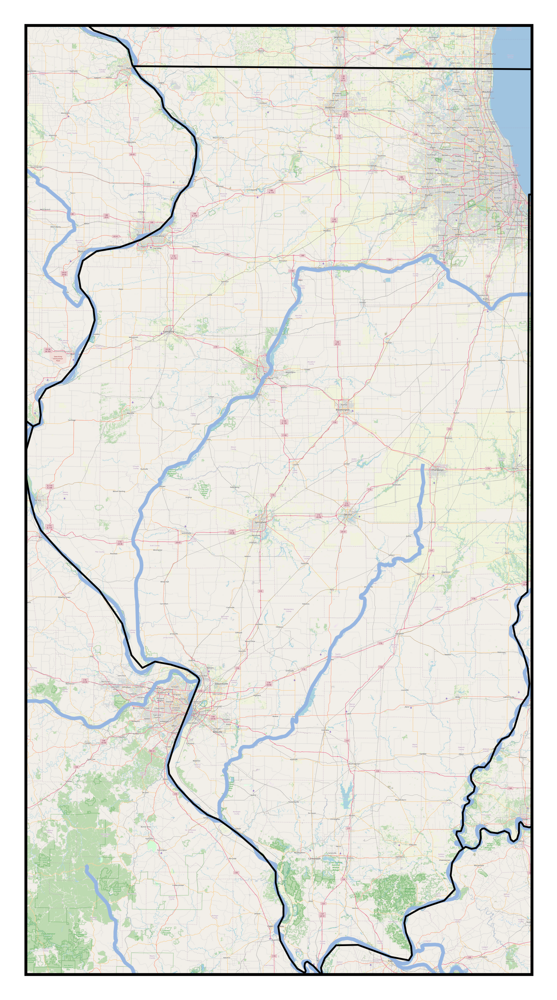

In [6]:
def make_map(projection=ccrs.PlateCarree()):
  fig, ax = plt.subplots(dpi=600,subplot_kw=dict(projection=projection))
  return fig, ax

extent = [-91.5, -87.5, 37, 42.75]

# request = cimgt.GoogleTiles(style='satellite')
request = cimgt.OSM()

fig, ax = make_map(projection=request.crs)
ax.set_extent(extent)

ax.add_image(request, 10, interpolation='spline36')

ax.add_feature(cfeature.LAKES, alpha =0.5) # Add lakes
ax.add_feature(cfeature.RIVERS) # Add rivers
ax.add_feature(cfeature.BORDERS, linestyle=":") # Add border
states_provinces = cfeature.NaturalEarthFeature(category='cultural',  name='admin_1_states_provinces_lines',
                                                scale='50m', linewidth=0.5, facecolor='none')
ax.add_feature(states_provinces, edgecolor='black', zorder=10)

## (legacy) Combined Location Analysis

#### Raw Data graph output

KeyError: "No variable named 't2m_c'. Variables on the dataset include ['number', 'latitude', 'longitude', 'date', 't2m', 'wb', 'hi']"

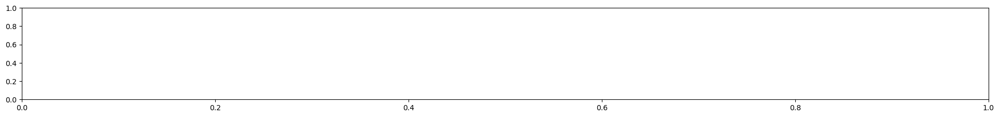

In [51]:
import warnings
warnings.filterwarnings('ignore', category=RuntimeWarning)

parameters = ["t2m_c", "tmp_wb", "heat_index", "d2m_c"]
parameter_names = ['surface tmp', 'wetbulb tmp', 'heat index', 'dewpoint tmp']

p_color = ['black', 'blue', 'red', 'orange']
p_lin = ['-', '-.', ':', '--']

plt.figure(figsize=[24,16])
for i, parameter in enumerate(parameters):
    for loc_ind in range(len(location_names)):
        location_ds = full_ds.sel(latitude=location_ddict[loc_ind][0],longitude=location_ddict[loc_ind][1])
        location_name = location_names[loc_ind]

        # Assigning variables
        location_ds = location_ds.assign(t2m_c=location_ds.t2m-273.15) 
        location_ds = location_ds.assign(d2m_c=location_ds.d2m-273.15) 
        
        rh = (location_ds.d2m_c/location_ds.t2m_c) * 100
        location_ds = location_ds.assign(tmp_wb=Wetbulb(location_ds.t2m_c,rh)) 
        
        tmp_f = (location_ds.t2m_c * 9/5) + 32
        location_ds = location_ds.assign(heat_index=Heat_Index(location_ds.t2m,rh / 100)) 
        
        # Clean the outliers for heat index
        data = location_ds.heat_index
        lower_bound, upper_bound = data.quantile([0.01, 0.99]) 
        cleaned_data = data.where((data >= lower_bound) & (data <= upper_bound), np.nan)
        # Change heat index to celcius
        cleaned_data = (cleaned_data - 32) * 5/9
        location_ds = location_ds.assign(heat_index=cleaned_data)
        
        # plotting
        plt.subplot(6,1,loc_ind+1);
        location_ds[parameter].plot(label=parameter_names[i], linestyle=p_lin[i], color=p_color[i], ms=1)
        
        plt.ylim(0,45);
        plt.legend(); plt.title(location_name);
    
    plt.tight_layout()

Available Year: 1940-2024


Enter year here:  2023


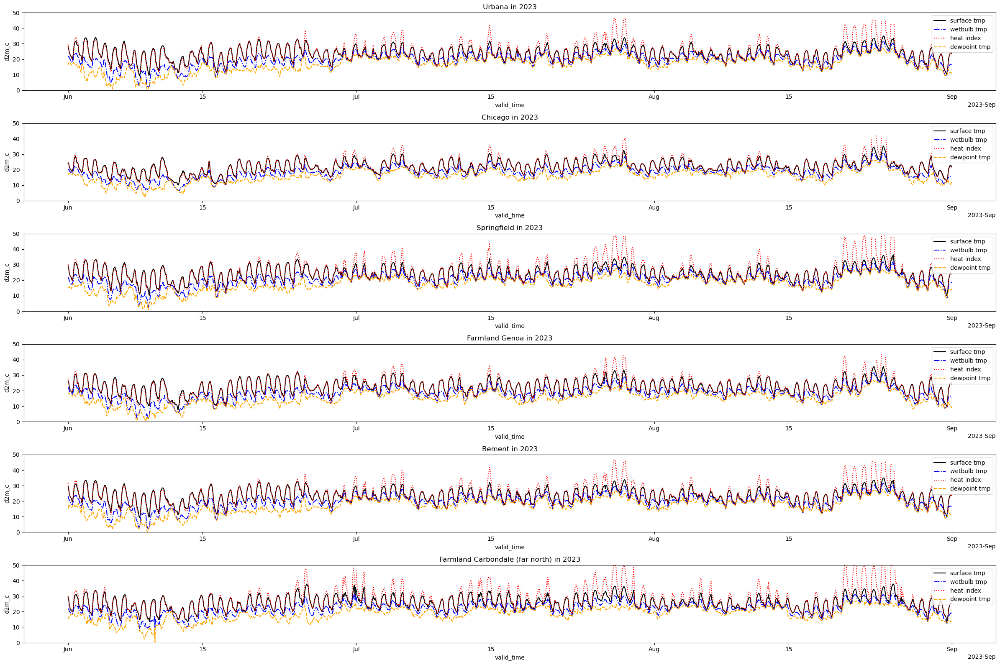

In [60]:
# Set up 
print("Available Year: 1940-2024")
year = input("Enter year here: ")

plt.figure(figsize=[24,16])
for i, parameter in enumerate(parameters):
    for loc_ind in range(len(location_names)):
        location_ds = full_ds.sel(latitude=location_ddict[loc_ind][0],longitude=location_ddict[loc_ind][1]).sel(valid_time=year)
        location_name = location_names[loc_ind]

        # Assigning variables
        location_ds = location_ds.assign(t2m_c=location_ds.t2m-273.15) 
        location_ds = location_ds.assign(d2m_c=location_ds.d2m-273.15) 
        
        rh = (location_ds.d2m_c/location_ds.t2m_c) * 100
        location_ds = location_ds.assign(tmp_wb=Wetbulb(location_ds.t2m_c,rh)) 
        
        tmp_f = (location_ds.t2m_c * 9/5) + 32
        location_ds = location_ds.assign(heat_index=Heat_Index(location_ds.t2m,rh / 100)) 
        
        # Clean the outliers for heat index
        data = location_ds.heat_index
        lower_bound, upper_bound = data.quantile([0.01, 0.99]) 
        cleaned_data = data.where((data >= lower_bound) & (data <= upper_bound), np.nan)
        # Change heat index to celcius
        cleaned_data = (cleaned_data - 32) * 5/9
        location_ds = location_ds.assign(heat_index=cleaned_data)
        
        # plotting
        plt.subplot(6,1,loc_ind+1);
        location_ds[parameter].plot(label=parameter_names[i], linestyle=p_lin[i], color=p_color[i], ms=1)
        
        plt.ylim(0,50);
        plt.legend(); plt.title(f"{location_name} in {year}");
    
    plt.tight_layout()

In [ ]:
## parameters = ["t2m_c", "tmp_wb", "heat_index", "d2m_c"]

plt.figure(figsize=[24,10])
for loc_ind in range(len(location_names)):
    plt.subplot(3,2,i+1);
    for i, parameter in enumerate(parameters):
        location_ds = full_ds.sel(latitude=location_ddict[loc_ind][0],longitude=location_ddict[loc_ind][1])
        location_name = location_names[loc_ind]

        # Assigning variables
        location_ds = location_ds.assign(t2m_c=location_ds.t2m-273.15) 
        location_ds = location_ds.assign(d2m_c=location_ds.d2m-273.15) 
        
        rh = (location_ds.d2m_c/location_ds.t2m_c) * 100
        location_ds = location_ds.assign(tmp_wb=Wetbulb(location_ds.t2m_c,rh)) 
        
        tmp_f = (location_ds.t2m_c * 9/5) + 32
        location_ds = location_ds.assign(heat_index=Heat_Index(location_ds.t2m,rh / 100)) 
        
        # Clean the outliers for heat index
        data = location_ds.heat_index
        lower_bound, upper_bound = data.quantile([0.01, 0.99]) 
        cleaned_data = data.where((data >= lower_bound) & (data <= upper_bound), np.nan)
        location_ds = location_ds.assign(heat_index=cleaned_data)

        # plotting
        location_ds[parameter].plot(label=location_name)
        
        plt.legend(); plt.title(parameters[i]);
    
    plt.tight_layout()

#### Daily highs graph outputs

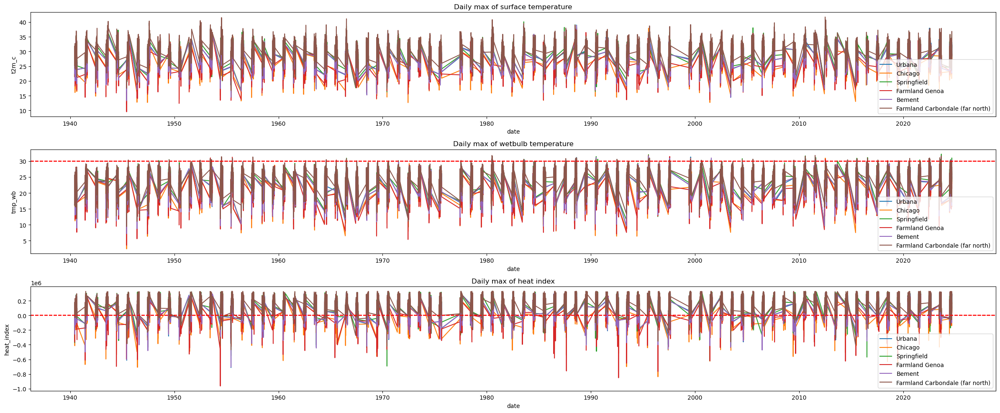

In [50]:
parameter_names = ['surface temperature', 'wetbulb temperature', 'heat index']

plt.figure(figsize=[24,10])
for i, parameter in enumerate(parameter_names):
    plt.subplot(3,1,i+1);
    for loc_ind in range(len(location_names)):
        # Loop over specific location
        location_ds = full_ds.sel(latitude=location_ddict[loc_ind][0],longitude=location_ddict[loc_ind][1])
        location_name = location_names[loc_ind]

        # Assigning variables
        location_ds = location_ds.assign(t2m_c=location_ds.t2m-273.15) 
        location_ds = location_ds.assign(d2m_c=location_ds.d2m-273.15) 
        
        rh = (location_ds.d2m_c/location_ds.t2m_c) * 100
        location_ds = location_ds.assign(tmp_wb=Wetbulb(location_ds.t2m_c,rh)) 
        
        tmp_f = (location_ds.t2m_c * 9/5) + 32
        location_ds = location_ds.assign(heat_index=Heat_Index(location_ds.t2m,rh / 100)) 
        
        # Clean the outliers for heat index
        data = location_ds.heat_index
        lower_bound, upper_bound = data.quantile([0.01, 0.99]) 
        cleaned_data = data.where((data >= lower_bound) & (data <= upper_bound), np.nan)
        location_ds = location_ds.assign(heat_index=cleaned_data)
        
        # Make Daily highs
        max_tmp = location_ds.t2m_c.groupby(location_ds.valid_time.dt.date).max()
        max_wb  = location_ds.tmp_wb.groupby(location_ds.valid_time.dt.date).max()
        max_hi  = location_ds.heat_index.groupby(location_ds.valid_time.dt.date).max()
        
        parameters = [max_tmp, max_wb, max_hi]
        
        # plotting
        parameters[i].plot(label=location_name);

        if i == 1:
            plt.axhline(y=30, color='red', linestyle='--')
        elif i == 2:
            plt.axhline(y=120, color='red', linestyle='--')
        
        plt.legend(); plt.title(f"Daily max of {parameter_names[i]}");

    plt.tight_layout()

Available Year: 1940-2024


Enter year here:  2023


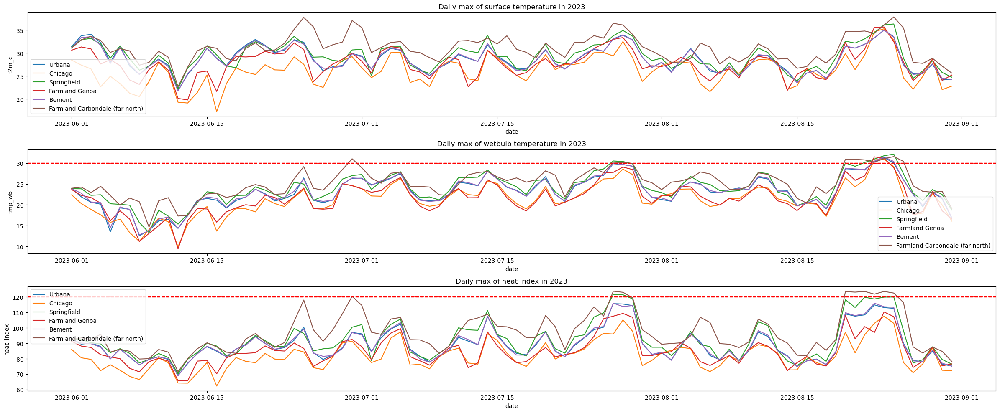

In [61]:
parameter_names = ['surface temperature', 'wetbulb temperature', 'heat index']

# Set up 
print("Available Year: 1940-2024")
year = input("Enter year here: ")

plt.figure(figsize=[24,10])
for i, parameter in enumerate(parameter_names):
    plt.subplot(3,1,i+1);
    for loc_ind in range(len(location_names)):
        # Loop over specific location
        location_ds = full_ds.sel(latitude=location_ddict[loc_ind][0],longitude=location_ddict[loc_ind][1]).sel(valid_time=year)
        location_name = location_names[loc_ind]        
        
        # Assigning variables
        location_ds = location_ds.assign(t2m_c=location_ds.t2m-273.15) 
        location_ds = location_ds.assign(d2m_c=location_ds.d2m-273.15) 
        
        rh = (location_ds.d2m_c/location_ds.t2m_c) * 100
        location_ds = location_ds.assign(tmp_wb=Wetbulb(location_ds.t2m_c,rh)) 
        
        tmp_f = (location_ds.t2m_c * 9/5) + 32
        location_ds = location_ds.assign(heat_index=Heat_Index(location_ds.t2m,rh / 100)) 
        
        # Clean the outliers for heat index
        data = location_ds.heat_index
        lower_bound, upper_bound = data.quantile([0.01, 0.99]) 
        cleaned_data = data.where((data >= lower_bound) & (data <= upper_bound), np.nan)
        location_ds = location_ds.assign(heat_index=cleaned_data)
        
        # Make Daily highs
        max_tmp = location_ds.t2m_c.groupby(location_ds.valid_time.dt.date).max()
        max_wb  = location_ds.tmp_wb.groupby(location_ds.valid_time.dt.date).max()
        max_hi  = location_ds.heat_index.groupby(location_ds.valid_time.dt.date).max()
        
        parameters = [max_tmp, max_wb, max_hi]
        
        # plotting
        parameters[i].plot(label=location_name);

        if i == 1:
            plt.axhline(y=30, color='red', linestyle='--')
        elif i == 2:
            plt.axhline(y=120, color='red', linestyle='--')
        
        plt.legend(); plt.title(f"Daily max of {parameter_names[i]} in {year}");

    plt.tight_layout()

### Quantile Test

#### Overall Trend

In [9]:
parameters = ['t2m_c', 'tmp_wb', 'heat_index']
names = ['surface temperature', 'wetbulb temperature', 'heat index']
location_names_short = ['Urbana', 'Chicago', 'Springfield', 'Farm_Genoa', 'Farm_Bement', 'Farm_Carbondale']
        
location_ds = full_ds.sel(latitude=location_ddict[0][0],longitude=location_ddict[0][1])
location_name = location_names[0]
location_name_short = location_names_short[0]

# Assigning variables
location_ds = location_ds.assign(t2m_c=location_ds.t2m-273.15) 
location_ds = location_ds.assign(d2m_c=location_ds.d2m-273.15) 

rh = (location_ds.d2m_c/location_ds.t2m_c) * 100
location_ds = location_ds.assign(tmp_wb=Wetbulb(location_ds.t2m_c,rh)) 

tmp_f = (location_ds.t2m_c * 9/5) + 32
location_ds = location_ds.assign(heat_index=Heat_Index(location_ds.t2m,rh / 100)) 

# Clean the outliers for heat index
data = location_ds.heat_index
lower_bound, upper_bound = data.quantile([0.01, 0.99]) 
cleaned_data = data.where((data >= lower_bound) & (data <= upper_bound), np.nan)
# Change heat index to celcius
cleaned_data = (cleaned_data - 32) * 5/9
location_ds = location_ds.assign(heat_index=cleaned_data)

# Make Daily highs
max_tmp = location_ds.t2m_c.groupby(location_ds.valid_time.dt.date).max()
max_wb  = location_ds.tmp_wb.groupby(location_ds.valid_time.dt.date).max()
max_hi  = location_ds.heat_index.groupby(location_ds.valid_time.dt.date).max()

parm_max = [max_tmp, max_wb, max_hi]

y = parm_max[0].fillna(parm_max[0].mean())
y = parm_max[0].values

X = np.ones((y.shape[0], 1))

/data/keeling/a/kchoo3/anaconda3/envs/myenv/lib/python3.12/site-packages/xarray/core/computation.py:825: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)


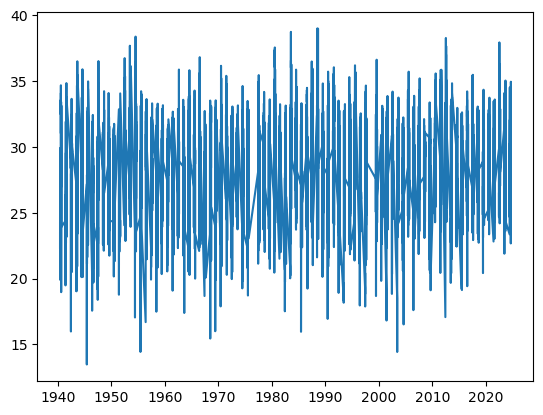

In [23]:
plt.plot(location_ds.valid_time.groupby(location_ds.valid_time.dt.date).max(), y)

In [99]:
X = location_ds.valid_time.groupby(location_ds.valid_time.dt.date).min()
int_X = X.values[:, np.newaxis].astype('datetime64[D]').astype('int64')

In [100]:
X

<xarray.DataArray 'valid_time' (date: 7636)> Size: 61kB
array(['1940-06-01T00:00:00.000000000', '1940-06-02T00:00:00.000000000',
       '1940-06-03T00:00:00.000000000', ...,
       '2024-08-29T00:00:00.000000000', '2024-08-30T00:00:00.000000000',
       '2024-08-31T00:00:00.000000000'], dtype='datetime64[ns]')
Coordinates:
    number     int64 8B 0
    latitude   float64 8B 40.0
    longitude  float64 8B -88.25
  * date       (date) object 61kB 1940-06-01 1940-06-02 ... 2024-08-31

In [85]:
qr = QuantileRegressor(quantile=0.95, alpha=0)
qr.fit(new_X, y)


y_pred = qr.predict(new_X)
y_pred

array([33.42624043, 33.42624565, 33.42625088, ..., 33.58694764,
       33.58695286, 33.58695808])

In [98]:
qr.coef_[0]

array([5.22285361e-06])

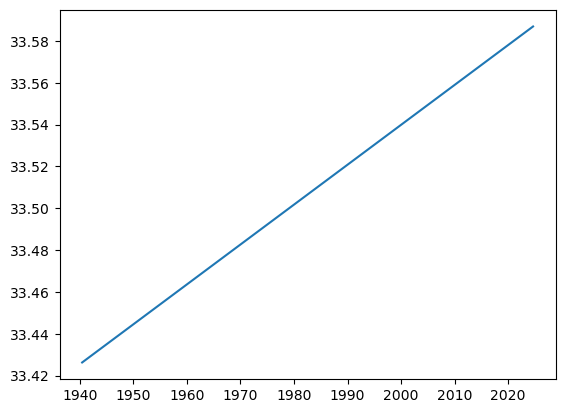

In [94]:
plt.plot(X, y_pred)

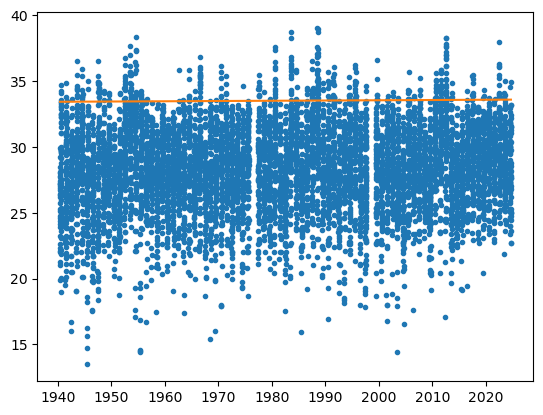

In [88]:
plt.plot(X, y, '.', label=f'Observed {names[i]}')
plt.plot(X, y_pred)

In [13]:
location_ds

<xarray.Dataset> Size: 9MB
Dimensions:     (valid_time: 185472)
Coordinates:
    number      int64 8B 0
  * valid_time  (valid_time) datetime64[ns] 1MB 1940-06-01 ... 2024-08-31T23:...
    latitude    float64 8B 40.0
    longitude   float64 8B -88.25
    expver      (valid_time) <U4 3MB '0001' '0001' '0001' ... '0001' '0001'
Data variables:
    d2m         (valid_time) float32 742kB 286.8 285.8 285.2 ... 289.0 289.4
    t2m         (valid_time) float32 742kB 290.7 289.3 288.2 ... 300.3 299.8
    t2m_c       (valid_time) float32 742kB 17.56 16.19 15.01 ... 27.16 26.69
    d2m_c       (valid_time) float32 742kB 13.65 12.69 12.04 ... 15.86 16.26
    tmp_wb      (valid_time) float32 742kB 14.92 13.69 12.77 ... 21.2 21.16
    heat_index  (valid_time) float32 742kB 17.4 15.91 14.67 ... 28.16 27.76
Attributes:
    GRIB_centre:             ecmf
    GRIB_centreDescription:  European Centre for Medium-Range Weather Forecasts
    GRIB_subCentre:          0
    Conventions:             CF-1.7
    institution:             European Centre for Medium-Range Weather Forecasts
    history:                 2024-12-04T06:37 GRIB to CDM+CF via cfgrib-0.9.1...

In [14]:
max_tmp.date.values

array([datetime.date(1940, 6, 1), datetime.date(1940, 6, 2),
       datetime.date(1940, 6, 3), ..., datetime.date(2024, 8, 29),
       datetime.date(2024, 8, 30), datetime.date(2024, 8, 31)],
      dtype=object)

/data/keeling/a/kchoo3/anaconda3/envs/myenv/lib/python3.12/site-packages/xarray/core/computation.py:825: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)
/data/keeling/a/kchoo3/anaconda3/envs/myenv/lib/python3.12/site-packages/xarray/core/computation.py:825: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)
/data/keeling/a/kchoo3/anaconda3/envs/myenv/lib/python3.12/site-packages/xarray/core/computation.py:825: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)


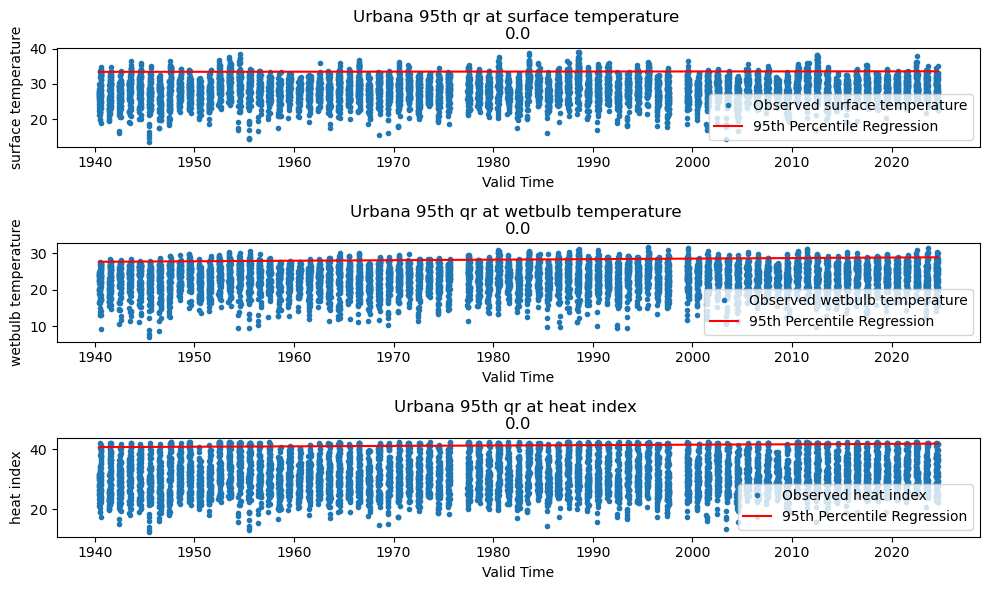

/data/keeling/a/kchoo3/anaconda3/envs/myenv/lib/python3.12/site-packages/xarray/core/computation.py:825: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)
/data/keeling/a/kchoo3/anaconda3/envs/myenv/lib/python3.12/site-packages/xarray/core/computation.py:825: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)
/data/keeling/a/kchoo3/anaconda3/envs/myenv/lib/python3.12/site-packages/xarray/core/computation.py:825: RuntimeWarning: invalid value encountered in sqrt
  result_data = func(*input_data)


ValueError: Input y contains NaN.

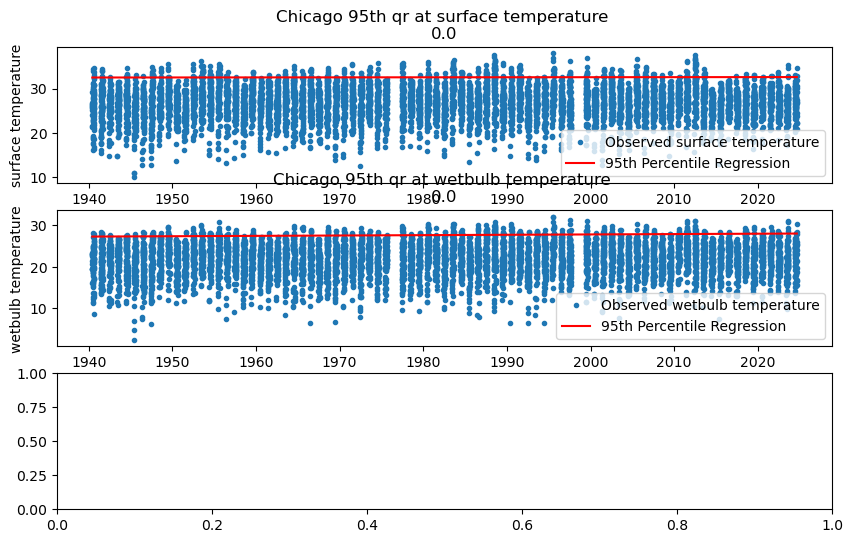

In [103]:
parameters = ['t2m_c', 'tmp_wb', 'heat_index']
names = ['surface temperature', 'wetbulb temperature', 'heat index']
location_names_short = ['Urbana', 'Chicago', 'Springfield', 'Farm_Genoa', 'Farm_Bement', 'Farm_Carbondale']

for loc_ind in range(len(location_names)):
    plt.figure(figsize=[10,6])
    for i, parameter in enumerate(parameters):
        plt.subplot(3,1,i+1);
        
        location_ds = full_ds.sel(latitude=location_ddict[loc_ind][0],longitude=location_ddict[loc_ind][1])
        location_name = location_names[loc_ind]
        location_name_short = location_names_short[loc_ind]

        # Assigning variables
        location_ds = location_ds.assign(t2m_c=location_ds.t2m-273.15) 
        location_ds = location_ds.assign(d2m_c=location_ds.d2m-273.15) 
        
        rh = (location_ds.d2m_c/location_ds.t2m_c) * 100
        location_ds = location_ds.assign(tmp_wb=Wetbulb(location_ds.t2m_c,rh)) 
        
        tmp_f = (location_ds.t2m_c * 9/5) + 32
        location_ds = location_ds.assign(heat_index=Heat_Index(location_ds.t2m,rh / 100)) 
        
        # Clean the outliers for heat index
        data = location_ds.heat_index
        lower_bound, upper_bound = data.quantile([0.01, 0.99]) 
        cleaned_data = data.where((data >= lower_bound) & (data <= upper_bound), np.nan)
        # Change heat index to celcius
        cleaned_data = (cleaned_data - 32) * 5/9
        location_ds = location_ds.assign(heat_index=cleaned_data)

        # Make Daily highs
        max_tmp = location_ds.t2m_c.groupby(location_ds.valid_time.dt.date).max()
        max_wb  = location_ds.tmp_wb.groupby(location_ds.valid_time.dt.date).max()
        max_hi  = location_ds.heat_index.groupby(location_ds.valid_time.dt.date).max()

        parm_max = [max_tmp, max_wb, max_hi]

        # Quantile test
        
        ds = location_ds
        
        ds = ds.sortby('valid_time') 
        # time_numeric = ds['valid_time'].astype('datetime64[s]').astype(int)
        
        # for y. Fill NaN values with mean values
        y = parm_max[i].fillna(parm_max[i].mean())
        y = parm_max[i].values
        
        X = location_ds.valid_time.groupby(location_ds.valid_time.dt.date).min()
        day_X = X.values[:, np.newaxis].astype('datetime64[D]').astype('int64')
        
        
        qr = QuantileRegressor(quantile=0.95, alpha=0)
        qr.fit(day_X, y)
        
        
        y_pred = qr.predict(day_X)
        
        
        # ds['heat_index_95th'] = (('valid_time'), y_pred)
        
        
        plt.plot(parm_max[i]['date'].values, y, '.', label=f'Observed {names[i]}')
        plt.plot(parm_max[i]['date'].values, y_pred, '-', color='red', label='95th Percentile Regression')
        plt.xlabel('Valid Time')
        plt.ylabel(names[i])
        plt.legend()
        plt.title(f'{location_name} 95th qr at {names[i]} \n{np.round(qr.coef_[0], 6)}')
    plt.tight_layout()
    plt.show()
    #plt.savefig(fname=f"{location_name_short}_{names[i]}")

#### Decade Trend

In [34]:
# Numpy Percentile

t_gg = np.percentile(max_tmp, 95)

alpha = max_tmp.sel(date=slice(dt.date(1940, 1, 1), dt.date(1950, 12, 31)))
alpha = np.percentile(alpha, 95)

beta_test = (t_gg - alpha) / 9
beta_test

-0.0037434895833333335

In [62]:
def quantile_reg(ds,quantile=0.95):
    
    # for y. Fill NaN values with mean values
    y = ds.fillna(ds.mean())
    y = ds.values
    
    X = np.ones((y.shape[0], 1))
    
    qr = QuantileRegressor(quantile=quantile, alpha=0)
    qr.fit(X, y)
    
    y_pred = qr.predict(X)

    return qr.intercept_, qr.coef_[0]

parameters = ['t2m_c', 'tmp_wb', 'heat_index']
names = ['surface temperature', 'wetbulb temperature', 'heat index']
location_names_short = ['Urbana', 'Chicago', 'Springfield', 'Farm_Genoa', 'Farm_Bement', 'Farm_Carbondale']

results = np.full(3, 1)

low_bnd = np.arange(1940, 2030, step=10)
upr_bnd = np.arange(1950, 2040, step=10)

for i, parameter in enumerate(parameters):
    print(parameter)
    
    data = np.full((np.arange(1940, 2030, step=10).size, full_ds.sizes['latitude'], full_ds.sizes['longitude']), np.nan)
    
    slopes = xr.DataArray(
        data=data,
        dims=["date", "latitude", "longitude"],
        coords=[np.arange(1940, 2030, step=10), full_ds.coords["latitude"], full_ds.coords["longitude"]],
    )

# ==========================================================================================

# ==========================================================================================
        
    location_ds = full_ds

    # Assigning variables
    location_ds = location_ds.assign(t2m_c=location_ds.t2m-273.15) 
    location_ds = location_ds.assign(d2m_c=location_ds.d2m-273.15) 
    
    rh = (location_ds.d2m_c/location_ds.t2m_c) * 100
    location_ds = location_ds.assign(tmp_wb=Wetbulb(location_ds.t2m_c,rh)) 
    
    tmp_f = (location_ds.t2m_c * 9/5) + 32
    location_ds = location_ds.assign(heat_index=Heat_Index(location_ds.t2m,rh / 100)) 
    
    # Clean the outliers for heat index
    data = location_ds.heat_index
    lower_bound, upper_bound = data.quantile([0.01, 0.99]) 
    cleaned_data = data.where((data >= lower_bound) & (data <= upper_bound), np.nan)
    # Change heat index to celcius
    cleaned_data = (cleaned_data - 32) * 5/9
    location_ds = location_ds.assign(heat_index=cleaned_data)

    # Make Daily highs
    max_tmp = location_ds.t2m_c.groupby(location_ds.valid_time.dt.date).max()
    max_wb  = location_ds.tmp_wb.groupby(location_ds.valid_time.dt.date).max()
    max_hi  = location_ds.heat_index.groupby(location_ds.valid_time.dt.date).max()
    
    parm_max = [max_tmp, max_wb, max_hi]

# ==========================================================================================

# ==========================================================================================

    # # for y. Fill NaN values with mean values
    # y = parm_max[i].fillna(parm_max[i].mean())
    # y = parm_max[i].values
    
    for lat_ind, lat in enumerate(parm_max[i].latitude.values):
        for lon_ind, lon in enumerate(parm_max[i].longitude.values):
            
            # Quantile test
    
            for trend_ind in range(len(low_bnd)):
                ds = parm_max[i].isel(latitude=lat_ind,longitude=lon_ind)
                ds = ds.sel(date=slice(dt.date(low_bnd[trend_ind], 1, 1), dt.date(upr_bnd[trend_ind], 12, 31)))
                try:
                    intercept, y_pred = quantile_reg(ds,quantile=0.95)
                except:
                    # print(ds)
                    print(f"trend_ind {trend_ind}")
                    print(f"lat: {lat_ind} lon: {lon_ind}")
                slopes[trend_ind][lat_ind][lon_ind] = intercept
                # print("beep")
    
    ds_name = slopes.to_dataset(name=parameters[i])
    ds_name.to_netcdf(f"{parameters[i]}_slope.nc")

t2m_c
tmp_wb
heat_index
trend_ind 0
lat: 0 lon: 0
trend_ind 2
lat: 0 lon: 0
trend_ind 0
lat: 0 lon: 1
trend_ind 2
lat: 0 lon: 1
trend_ind 0
lat: 0 lon: 2
trend_ind 2
lat: 0 lon: 2
trend_ind 0
lat: 0 lon: 3
trend_ind 0
lat: 0 lon: 4
trend_ind 0
lat: 0 lon: 5
trend_ind 0
lat: 0 lon: 6
trend_ind 0
lat: 0 lon: 7
trend_ind 0
lat: 0 lon: 8
trend_ind 0
lat: 0 lon: 9
trend_ind 0
lat: 0 lon: 10
trend_ind 0
lat: 0 lon: 11
trend_ind 0
lat: 0 lon: 12
trend_ind 2
lat: 0 lon: 12
trend_ind 0
lat: 0 lon: 13
trend_ind 1
lat: 0 lon: 13
trend_ind 2
lat: 0 lon: 13
trend_ind 0
lat: 0 lon: 14
trend_ind 1
lat: 0 lon: 14
trend_ind 2
lat: 0 lon: 14
trend_ind 0
lat: 0 lon: 15
trend_ind 1
lat: 0 lon: 15
trend_ind 2
lat: 0 lon: 15
trend_ind 0
lat: 0 lon: 16
trend_ind 1
lat: 0 lon: 16
trend_ind 2
lat: 0 lon: 16
trend_ind 3
lat: 0 lon: 16
trend_ind 5
lat: 0 lon: 16
trend_ind 6
lat: 0 lon: 16
trend_ind 7
lat: 0 lon: 16
trend_ind 0
lat: 0 lon: 17
trend_ind 1
lat: 0 lon: 17
trend_ind 2
lat: 0 lon: 17
trend_ind 3
lat: 

### Decedal Change

1950,1960...,2020
ex: 1950 is showing the trend from 1950-1960 compared to 1940-1950


Enter your selection:  1950


<Figure size 640x480 with 0 Axes>

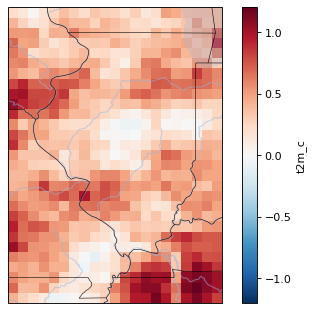

<Figure size 640x480 with 0 Axes>

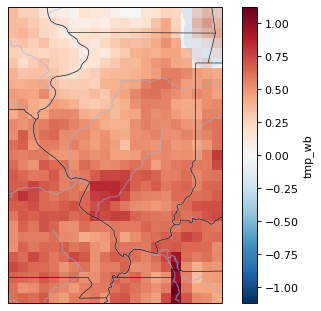

<Figure size 640x480 with 0 Axes>

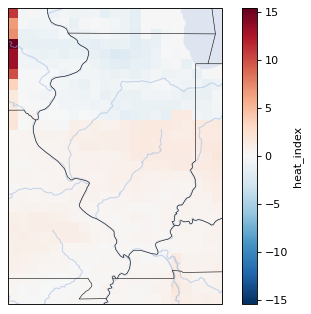

In [79]:
parameters = ['t2m_c', 'tmp_wb', 'heat_index']

print("1950,1960...,2020")
print("ex: 1950 is showing the trend from 1950-1960 compared to 1940-1950")
selection = input("Enter your selection: ")
selection = int(selection)

for i in range(len(parameters)):
    plt.figure()
    
    ds = xr.open_dataset(f"{parameters[i]}_slope.nc")
    
    anom = ds[parameters[i]].sel(date=selection) - ds[parameters[i]].sel(date=selection-10)
    
    def make_map(projection=ccrs.PlateCarree()):
      fig, ax = plt.subplots(dpi=80,subplot_kw=dict(projection=projection))
      return fig, ax
    
    fig, ax = plt.subplots(dpi=80,subplot_kw=dict(projection=ccrs.PlateCarree()))
    
    ax.add_feature(cfeature.LAKES, alpha =0.25) # Add lakes
    ax.add_feature(cfeature.RIVERS, alpha=0.5) # Add rivers
    ax.add_feature(cfeature.BORDERS, linestyle=":") # Add border
    states_provinces = cfeature.NaturalEarthFeature(category='cultural',  name='admin_1_states_provinces_lines',
                                                    scale='50m', linewidth=0.5, facecolor='none')
    ax.add_feature(states_provinces, edgecolor='black', zorder=10)
    
    
    anom.plot()

### Cumulated Change
This is done by subtracting the 95th quantile of the first 10 years (1940-1950) and the last 10 years (2020-2030)

<Figure size 640x480 with 0 Axes>

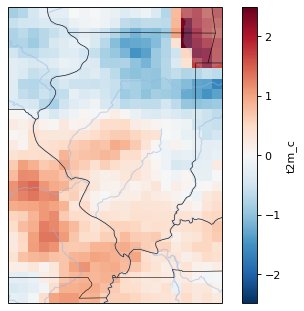

<Figure size 640x480 with 0 Axes>

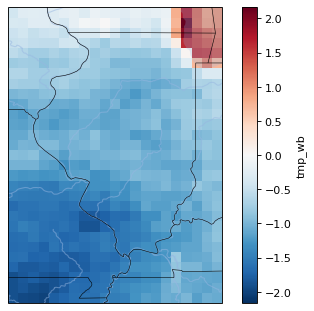

<Figure size 640x480 with 0 Axes>

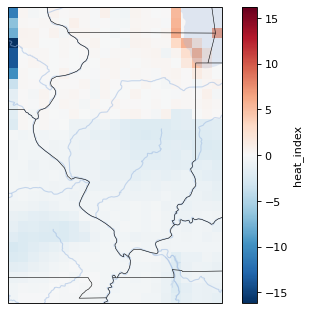

In [80]:
parameters = ['t2m_c', 'tmp_wb', 'heat_index']

for i in range(len(parameters)):
    plt.figure()
    
    ds = xr.open_dataset(f"{parameters[i]}_slope.nc")
    
    anom = ds[parameters[i]].isel(date=0) - ds[parameters[i]].isel(date=-1)
    
    def make_map(projection=ccrs.PlateCarree()):
      fig, ax = plt.subplots(dpi=80,subplot_kw=dict(projection=projection))
      return fig, ax
    
    fig, ax = plt.subplots(dpi=80,subplot_kw=dict(projection=ccrs.PlateCarree()))
    
    ax.add_feature(cfeature.LAKES, alpha =0.25) # Add lakes
    ax.add_feature(cfeature.RIVERS, alpha=0.5) # Add rivers
    ax.add_feature(cfeature.BORDERS, linestyle=":") # Add border
    states_provinces = cfeature.NaturalEarthFeature(category='cultural',  name='admin_1_states_provinces_lines',
                                                    scale='50m', linewidth=0.5, facecolor='none')
    ax.add_feature(states_provinces, edgecolor='black', zorder=10)
    
    
    anom.plot()

##### Ignore this for now

In [5]:
# Quantile test

def quantile_reg(ds,quantile=0.95):
    
    # for y. Fill NaN values with mean values
    y = ds.fillna(ds.mean())
    y = ds.values
    
    X = np.ones((y.shape[0], 1))
    
    qr = QuantileRegressor(quantile=quantile, alpha=0)
    qr.fit(X, y)
    
    y_pred = qr.predict(X)

    return qr.intercept_, y_pred
    
def get_quantile(y,quantile=0.95):
    qr = QuantileRegressor(quantile=quantile,alpha=0)
    qr.fit(X, y)
    return qr.intercept_

In [43]:
def quantile_region(ds,quantile=0.95):
    new_y = [[[[0 for _ in range(3)]]]
    for lat_ind in range(len(ds.z)):
        # for y. Fill NaN values with mean values
        new_ds = ds.isel(z=z_ind)
        
        y = new_ds.fillna(new_ds.mean())
        y = new_ds.values
        
        X = np.ones((y.shape[0], 1))
        
        qr = QuantileRegressor(quantile=quantile, alpha=0)
        qr.fit(X, y)
        
        y_pred = qr.predict(X)
    
        return y_pred

In [33]:
location_ds = full_ds
# Assigning variables
location_ds = location_ds.assign(t2m_c=location_ds.t2m-273.15) 
location_ds = location_ds.assign(d2m_c=location_ds.d2m-273.15) 

rh = (location_ds.d2m_c/location_ds.t2m_c) * 100
location_ds = location_ds.assign(tmp_wb=Wetbulb(location_ds.t2m_c,rh)) 

tmp_f = (location_ds.t2m_c * 9/5) + 32
location_ds = location_ds.assign(heat_index=Heat_Index(tmp_f,rh)) 

# Clean the outliers for heat index
data = location_ds.heat_index
lower_bound, upper_bound = data.quantile([0.01, 0.99]) 
cleaned_data = data.where((data >= lower_bound) & (data <= upper_bound), np.nan)
# Change heat index to celcius
cleaned_data = (cleaned_data - 32) * 5/9
location_ds = location_ds.assign(heat_index=cleaned_data)

max_tmp = location_ds.t2m_c.groupby(location_ds.valid_time.dt.date).max()

ds = max_tmp.sel(date=slice(dt.date(low_bnd[i], 1, 1), dt.date(upr_bnd[i], 12, 31)))

intercept, y_pred = quantile_reg(ds,quantile=0.95)

<xarray.DataArray 't2m_c' (date: 460, latitude: 29, longitude: 21)> Size: 1MB
array([[[29.36905 , 28.790924, 28.505768, ..., 12.955963, 12.82901 ,
         13.166901],
        [29.41983 , 28.86905 , 28.246002, ..., 13.221588, 13.262604,
         13.520416],
        [29.437408, 28.772125, 28.110016, ..., 13.606354, 13.651276,
         14.166901],
        ...,
        [27.051422, 26.934235, 26.861969, ..., 27.389313, 27.57486 ,
         27.576813],
        [27.420563, 27.319   , 27.354156, ..., 27.35611 , 27.53775 ,
         27.53189 ],
        [27.41861 , 27.615875, 27.651031, ..., 27.867828, 27.711578,
         27.635406]],

       [[32.313873, 32.134186, 32.085358, ..., 16.540924, 15.037018,
         14.579987],
        [32.55606 , 32.339264, 32.208405, ..., 17.267487, 15.761627,
         15.115143],
        [32.78653 , 32.481842, 32.272858, ..., 17.548737, 16.406158,
         15.716705],
...
        [33.64981 , 33.0795  , 32.84659 , ..., 35.108307, 35.61026 ,
         35.72159 ],
        [33.695465, 33.180573, 33.028717, ..., 34.694244, 35.18448 ,
         35.40909 ],
        [33.04312 , 33.14859 , 33.339264, ..., 34.705963, 34.61612 ,
         34.782135]],

       [[26.918121, 26.99234 , 27.291168, ..., 23.980133, 23.741852,
         23.414215],
        [27.06607 , 27.027008, 27.134918, ..., 23.919586, 23.689606,
         23.55362 ],
        [27.200836, 27.006012, 26.980621, ..., 23.997711, 23.79898 ,
         23.540436],
        ...,
        [30.458893, 30.80655 , 30.68155 , ..., 33.42984 , 33.69156 ,
         33.170074],
        [31.193268, 31.621002, 31.958893, ..., 33.252106, 33.50406 ,
         32.789215],
        [31.402252, 32.232086, 33.17935 , ..., 33.175934, 33.412262,
         32.662262]]], dtype=float32)
Coordinates:
    number     int64 8B 0
  * latitude   (latitude) float64 232B 43.0 42.75 42.5 42.25 ... 36.5 36.25 36.0
  * longitude  (longitude) float64 168B -92.0 -91.75 -91.5 ... -87.25 -87.0
  * date       (date) object 4kB 2020-06-01 2020-06-02 ... 2024-08-30 2024-08-31

In [39]:
intercept, y_pred = quantile_reg(ds.mean(dim=['latitude','longitude']),quantile=0.95)
intercept

33.120635986328125

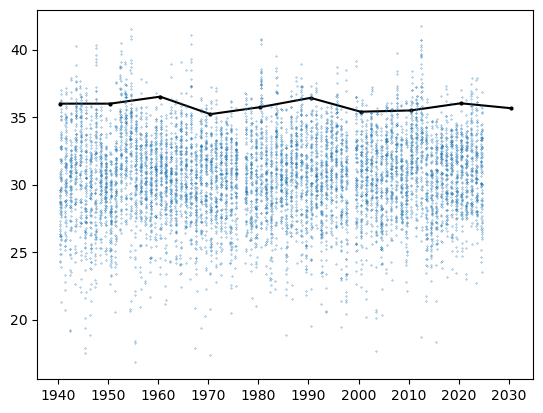

In [29]:
# some testing Demo
low_bnd = np.arange(1940, 2030, step=10)
upr_bnd = np.arange(1950, 2040, step=10)

x_plot = []
y_plot = []

x_plot.append(dt.date(1940, 6, 1))


location_ds = full_ds
# Assigning variables
location_ds = location_ds.assign(t2m_c=location_ds.t2m-273.15) 
location_ds = location_ds.assign(d2m_c=location_ds.d2m-273.15) 

rh = (location_ds.d2m_c/location_ds.t2m_c) * 100
location_ds = location_ds.assign(tmp_wb=Wetbulb(location_ds.t2m_c,rh)) 

tmp_f = (location_ds.t2m_c * 9/5) + 32
location_ds = location_ds.assign(heat_index=Heat_Index(tmp_f,rh)) 

# Clean the outliers for heat index
data = location_ds.heat_index
lower_bound, upper_bound = data.quantile([0.01, 0.99]) 
cleaned_data = data.where((data >= lower_bound) & (data <= upper_bound), np.nan)
# Change heat index to celcius
cleaned_data = (cleaned_data - 32) * 5/9
location_ds = location_ds.assign(heat_index=cleaned_data)

max_tmp = full_ds.t2m_c.groupby(full_ds.valid_time.dt.date).max()

for i in range(len(low_bnd)):
    ds = max_tmp.sel(date=slice(dt.date(low_bnd[i], 1, 1), dt.date(upr_bnd[i], 12, 31)))
    intercept, y_pred = quantile_reg(ds,quantile=0.95)
    x_plot.append(dt.date(upr_bnd[i], 6, 1))
    y_plot.append(intercept)
    if i == 0:
        y_plot.append(intercept)
        
# Use apply_ufunc to apply regression_slope over the grid.
trend = xr.apply_ufunc(
    quantile_reg,
    decadal_quantiles['t2m'],  # this should be the DataArray with dimensions (decade, lat, lon)
    input_core_dims=[['decade']],
    kwargs={'decades': decades},
    vectorize=True
)

plt.plot(x_plot, y_plot, "o", markersize=2, color="black")
plt.plot(x_plot, y_plot, color="black")

y = max_tmp.fillna(max_tmp.mean())
y = max_tmp.values
plt.plot(max_tmp['date'].values, y, '.', label=f'Observed', markersize=0.5)    
    

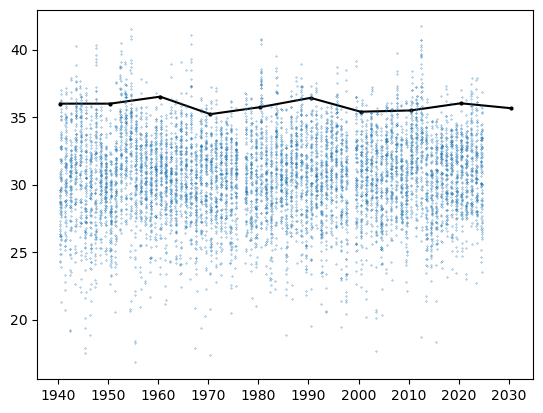

In [29]:
# some testing Demo
low_bnd = np.arange(1940, 2030, step=10)
upr_bnd = np.arange(1950, 2040, step=10)

x_plot = []
y_plot = []

x_plot.append(dt.date(1940, 6, 1))

for i in range(len(low_bnd)):
    ds = max_tmp.sel(date=slice(dt.date(low_bnd[i], 1, 1), dt.date(upr_bnd[i], 12, 31)))
    intercept, y_pred = quantile_reg(ds,quantile=0.95)
    x_plot.append(dt.date(upr_bnd[i], 6, 1))
    y_plot.append(intercept)
    if i == 0:
        y_plot.append(intercept)
        

plt.plot(x_plot, y_plot, "o", markersize=2, color="black")
plt.plot(x_plot, y_plot, color="black")

y = max_tmp.fillna(max_tmp.mean())
y = max_tmp.values
plt.plot(max_tmp['date'].values, y, '.', label=f'Observed', markersize=0.5)    
    

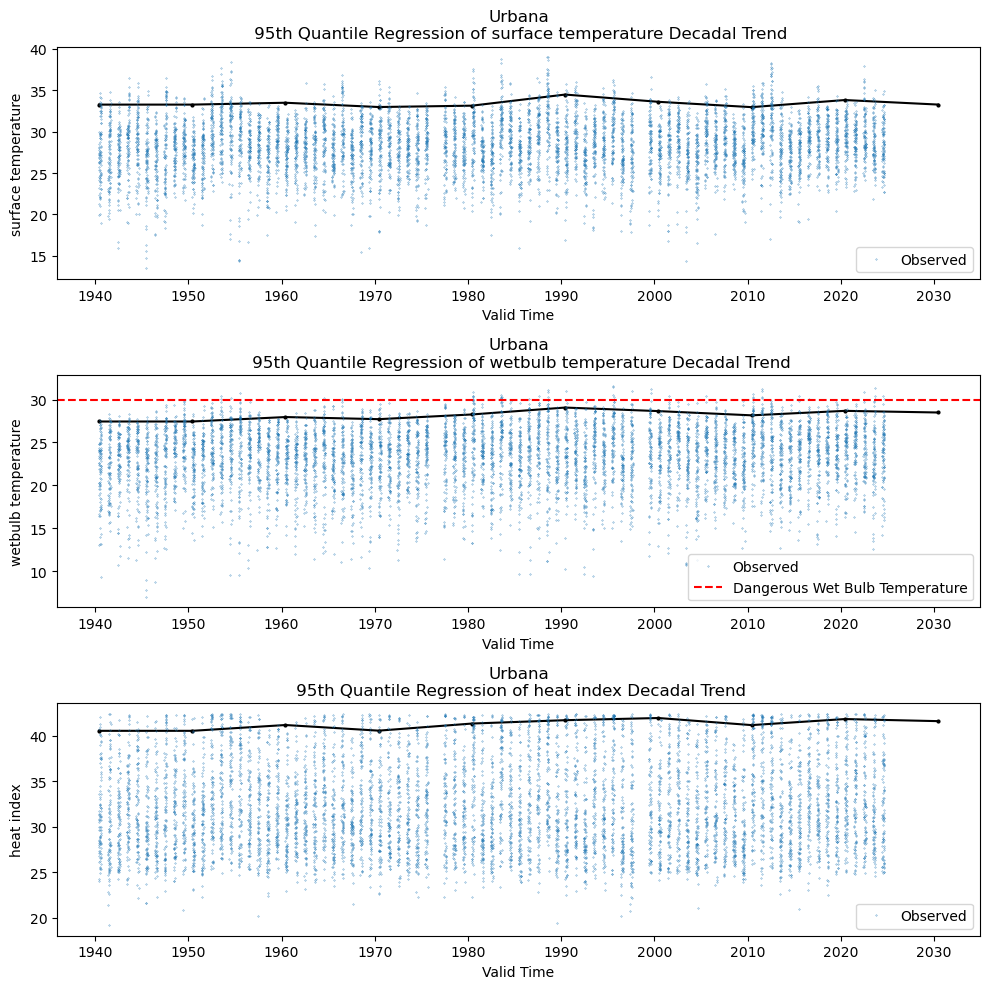

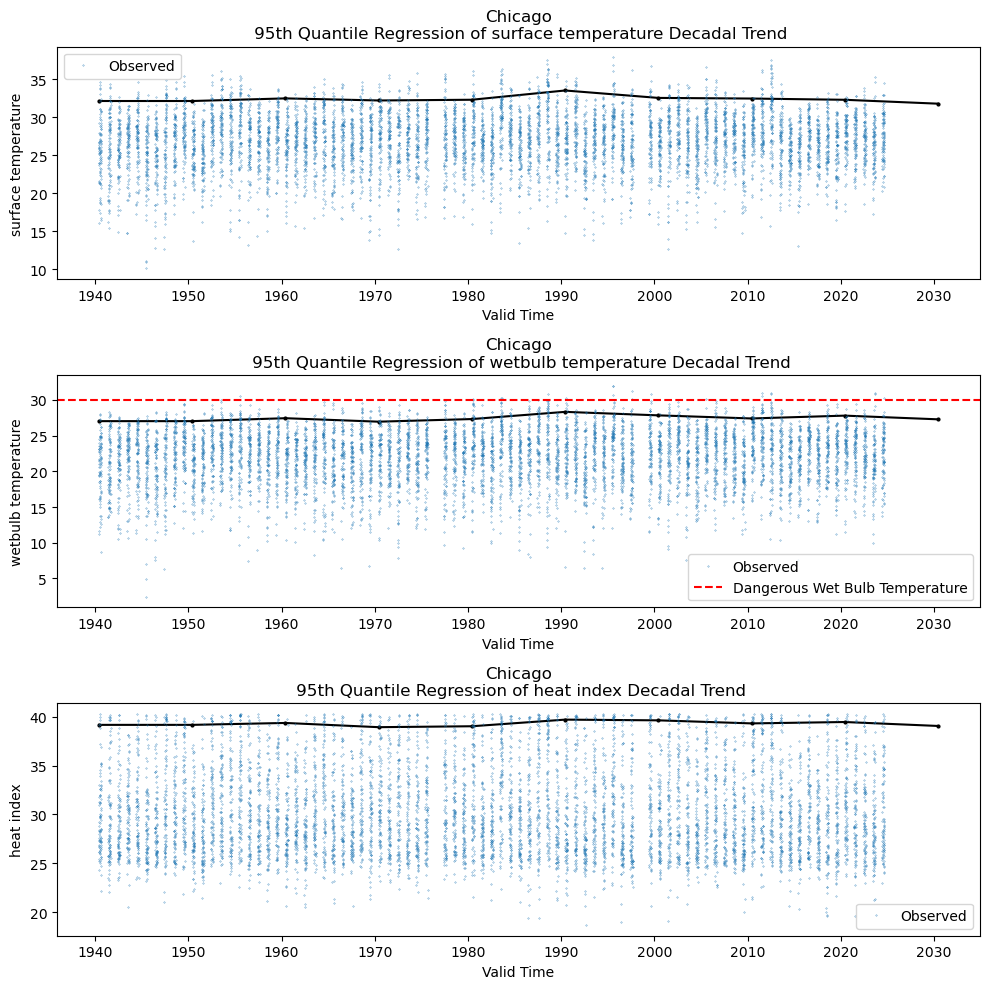

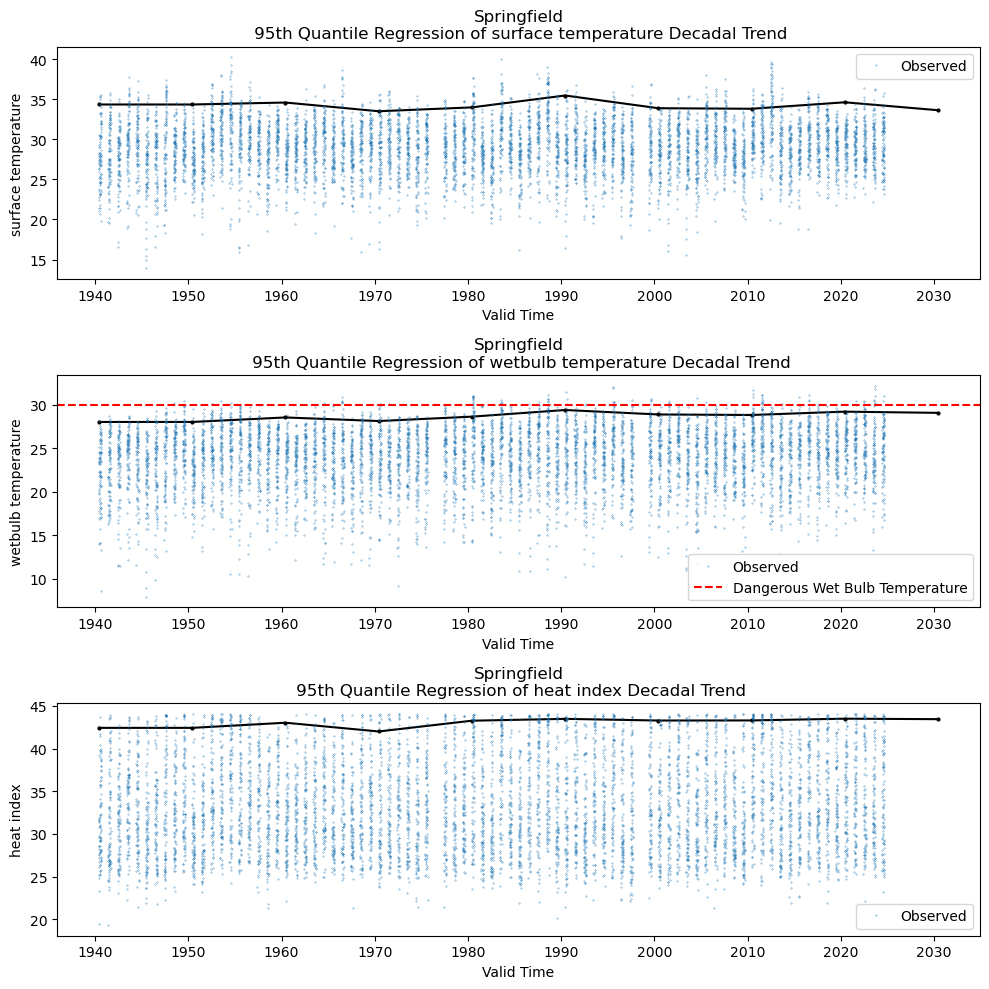

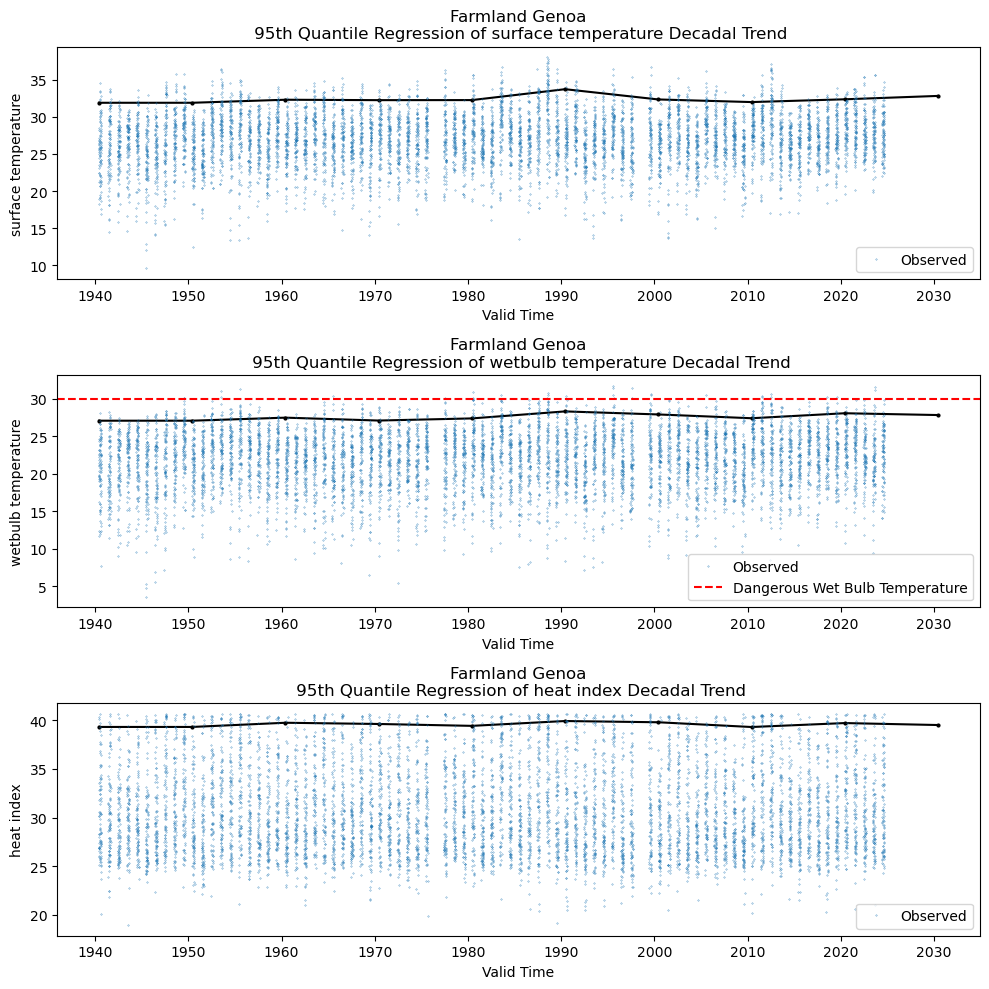

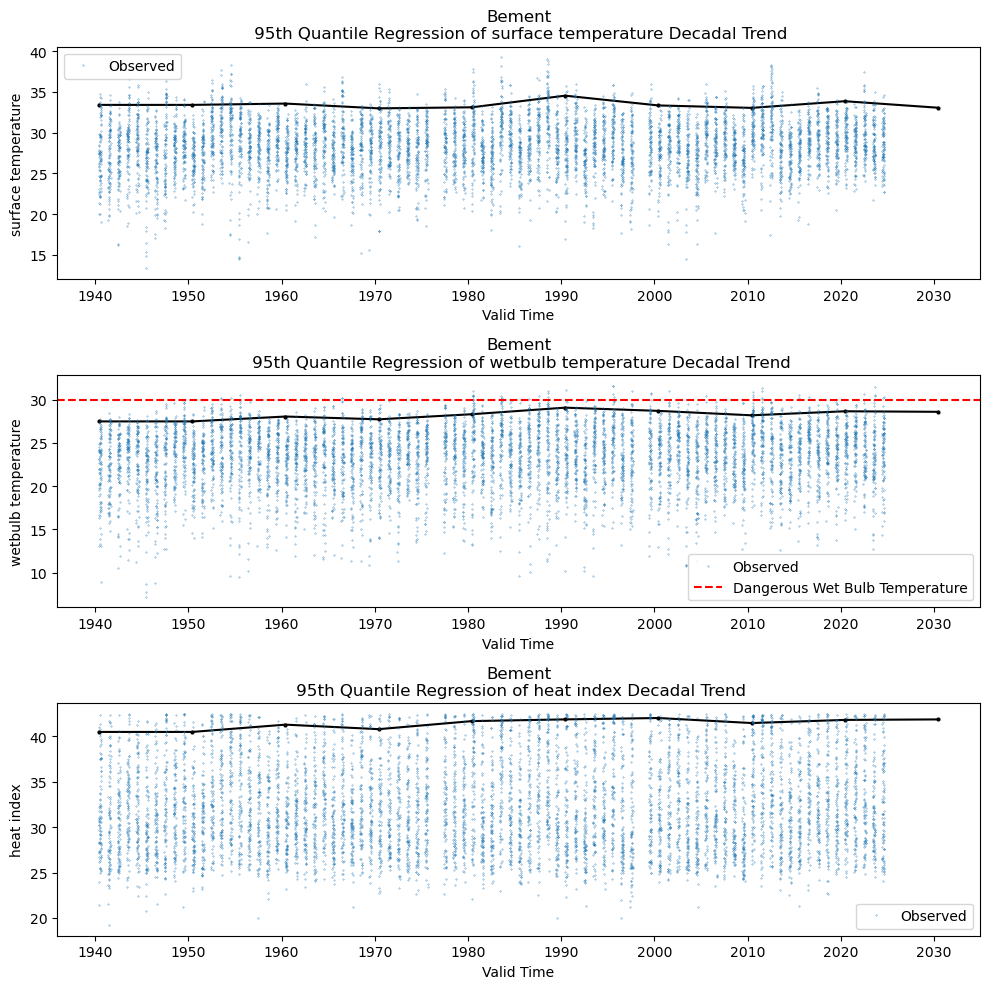

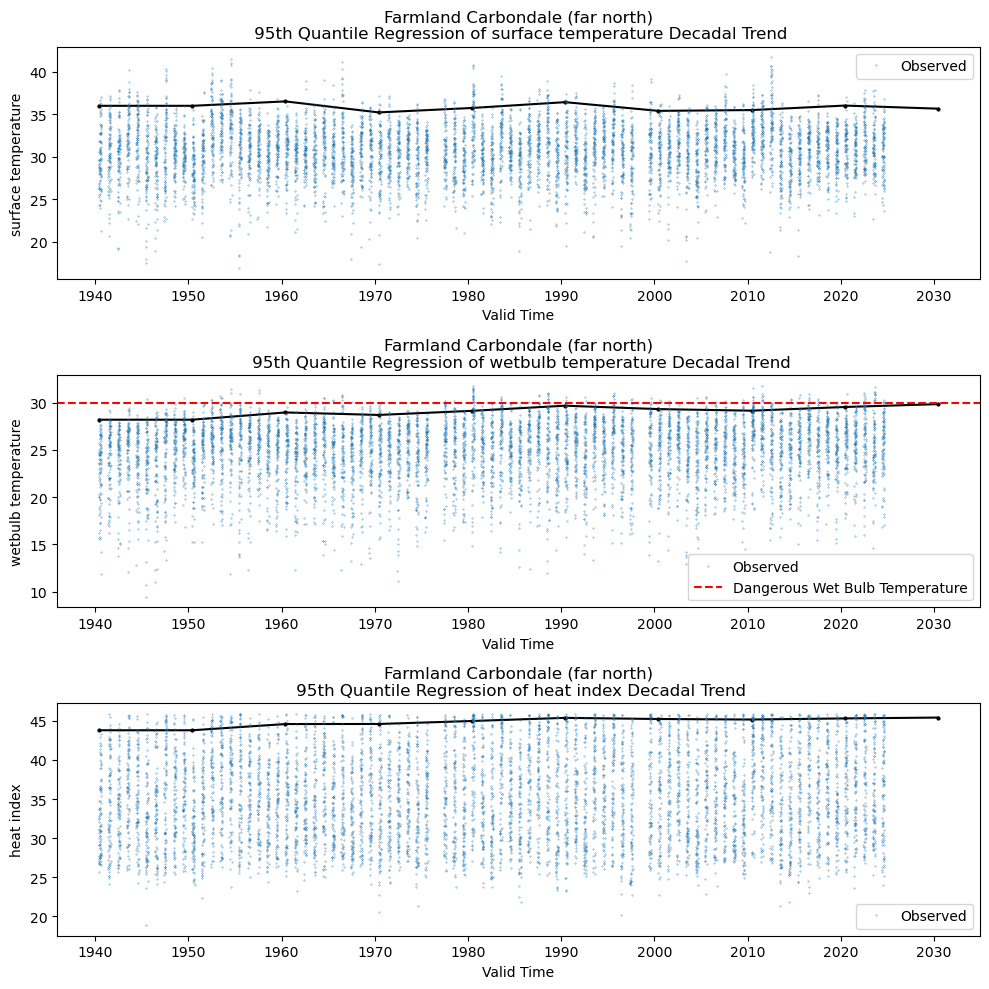

In [14]:
parameters = ['t2m_c', 'tmp_wb', 'heat_index']
names = ['surface temperature', 'wetbulb temperature', 'heat index']
location_names_short = ['Urbana', 'Chicago', 'Springfield', 'Farm_Genoa', 'Farm_Bement', 'Farm_Carbondale']

low_bnd = np.arange(1940, 2030, step=10)
upr_bnd = np.arange(1950, 2040, step=10)

for loc_ind in range(len(location_names)):
    plt.figure(figsize=[10,10])
    for i, parameter in enumerate(parameters):
        plt.subplot(3,1,i+1);
        
        location_ds = full_ds.sel(latitude=location_ddict[loc_ind][0],longitude=location_ddict[loc_ind][1])
        location_name = location_names[loc_ind]
        location_name_short = location_names_short[loc_ind]

        # Assigning variables
        location_ds = location_ds.assign(t2m_c=location_ds.t2m-273.15) 
        location_ds = location_ds.assign(d2m_c=location_ds.d2m-273.15) 
        
        rh = (location_ds.d2m_c/location_ds.t2m_c) * 100
        location_ds = location_ds.assign(tmp_wb=Wetbulb(location_ds.t2m_c,rh)) 
        
        tmp_f = (location_ds.t2m_c * 9/5) + 32
        location_ds = location_ds.assign(heat_index=Heat_Index(tmp_f,rh)) 
        
        # Clean the outliers for heat index
        data = location_ds.heat_index
        lower_bound, upper_bound = data.quantile([0.01, 0.99]) 
        cleaned_data = data.where((data >= lower_bound) & (data <= upper_bound), np.nan)
        # Change heat index to celcius
        cleaned_data = (cleaned_data - 32) * 5/9
        location_ds = location_ds.assign(heat_index=cleaned_data)

        # Make Daily highs
        max_tmp = location_ds.t2m_c.groupby(location_ds.valid_time.dt.date).max()
        max_wb  = location_ds.tmp_wb.groupby(location_ds.valid_time.dt.date).max()
        max_hi  = location_ds.heat_index.groupby(location_ds.valid_time.dt.date).max()

        parm_max = [max_tmp, max_wb, max_hi]

        # Quantile test

        # for y. Fill NaN values with mean values
        y = parm_max[i].fillna(parm_max[i].mean())
        y = parm_max[i].values

        x_reg = []
        y_reg = []

        # add the beginning
        x_reg.append(dt.date(1940, 6, 1))
        
        for trend_ind in range(len(low_bnd)):
            ds = parm_max[i].sel(date=slice(dt.date(low_bnd[trend_ind], 1, 1), dt.date(upr_bnd[trend_ind], 12, 31)))
            intercept, y_pred = quantile_reg(ds,quantile=0.95)
            x_reg.append(dt.date(upr_bnd[trend_ind], 6, 1))
            y_reg.append(intercept)

            # make a line a the beginning
            if trend_ind == 0:
                y_reg.append(intercept)
                
        
        plt.plot(x_reg, y_reg, "o", markersize=2, color="black")
        plt.plot(x_reg, y_reg, color="black")
        

        plt.plot(parm_max[i]['date'].values, y, '.', label=f'Observed', markersize=0.5)    

        if i == 1:
            plt.axhline(y=30, color='red', linestyle='--', label='Dangerous Wet Bulb Temperature')
        
        # ds['heat_index_95th'] = (('valid_time'), y_pred)
        
        
        #plt.plot(parm_max[i]['date'].values, y, '.', label=f'Observed {names[i]}')
        #plt.plot(parm_max[i]['date'].values, y_pred, '-', color='red', label='95th Percentile Regression')
        plt.xlabel('Valid Time')
        plt.ylabel(names[i])
        plt.legend()
        plt.title(f'{location_name}\n 95th Quantile Regression of {names[i]} Decadal Trend')
    plt.tight_layout()
    plt.show()

## Specific Location Analysis

In [8]:
# RUN THIS CELL FIRST
# Assigning variables

location_ds = location_ds.assign(t2m_c=location_ds.t2m-273.15) 
location_ds = location_ds.assign(d2m_c=location_ds.d2m-273.15) 

rh = (location_ds.d2m_c/location_ds.t2m_c) * 100
location_ds = location_ds.assign(tmp_wb=Wetbulb(location_ds.t2m_c,rh)) 

tmp_f = (location_ds.t2m_c * 9/5) + 32
location_ds = location_ds.assign(heat_index=Heat_Index(tmp_f,rh)) 

# Clean the outliers for heat index
data = location_ds.heat_index
lower_bound, upper_bound = data.quantile([0.01, 0.99]) 
cleaned_data = data.where((data >= lower_bound) & (data <= upper_bound), np.nan)
location_ds = location_ds.assign(heat_index=cleaned_data) 

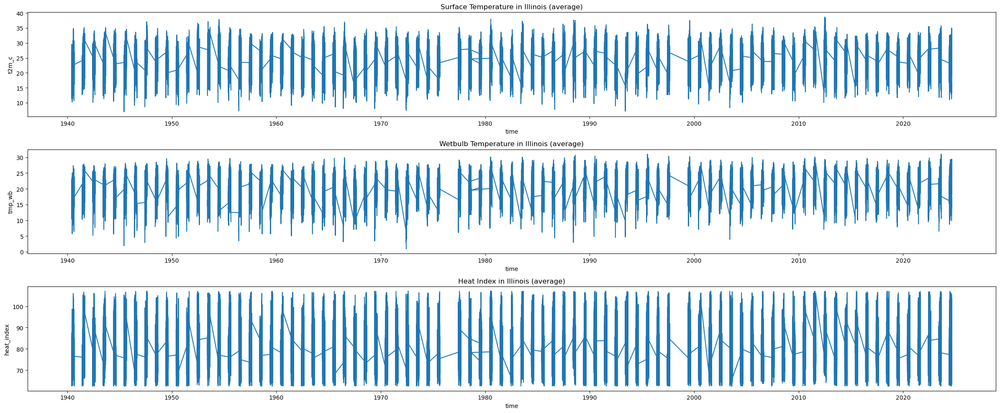

In [9]:
plt.figure(figsize=[24,10])

plt.subplot(3,1,1); location_ds.t2m_c.plot(); plt.title(f"Surface Temperature in {location_name}");
plt.subplot(3,1,2); location_ds.tmp_wb.plot(); plt.title(f"Wetbulb Temperature in {location_name}");
plt.subplot(3,1,3); location_ds.heat_index.plot(); plt.title(f"Heat Index in {location_name}");

plt.tight_layout();

Available Year: 1940-2024


Enter year here:  2023


Dangerous Wet Bulb Temperature. Total Hour 4
Intersection: 2023-08-23T17
Intersection: 2023-08-23T23
Intersection: 2023-08-24T16
Intersection: 2023-08-24T23
Dangerous Heat Index Temperature. Total Hour 86
Intersection: 2023-07-27T16
Intersection: 2023-07-27T17
Intersection: 2023-07-27T18
Intersection: 2023-07-27T19
Intersection: 2023-07-27T20
Intersection: 2023-07-27T21
Intersection: 2023-07-27T22
Intersection: 2023-07-27T23
Intersection: 2023-07-28T00
Intersection: 2023-07-28T16
Intersection: 2023-07-28T17
Intersection: 2023-07-28T18
Intersection: 2023-07-28T19
Intersection: 2023-07-28T20
Intersection: 2023-07-28T21
Intersection: 2023-07-28T22
Intersection: 2023-07-28T23
Intersection: 2023-07-29T00
Intersection: 2023-08-06T09
Intersection: 2023-08-06T10
Intersection: 2023-08-06T11
Intersection: 2023-08-08T09
Intersection: 2023-08-08T10
Intersection: 2023-08-08T11
Intersection: 2023-08-08T12
Intersection: 2023-08-09T09
Intersection: 2023-08-09T10
Intersection: 2023-08-09T11
Intersectio

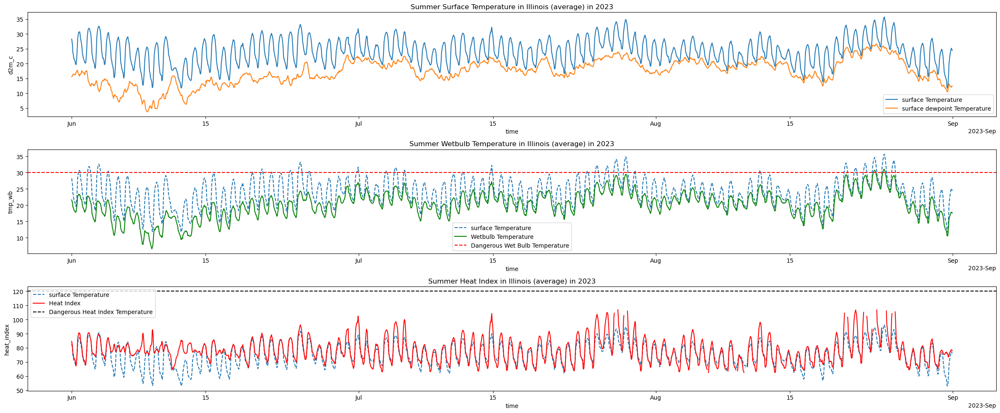

In [10]:
plt.figure(figsize=[24,10])

# Set up 
print("Available Year: 1940-2024")
year = input("Enter year here: ")

# Graph for 
plt.subplot(3,1,1); 

location_ds.sel(valid_time=year).t2m_c.plot(label='surface Temperature'); 
location_ds.sel(valid_time=year).d2m_c.plot(label='surface dewpoint Temperature'); 

plt.legend(); plt.title(f"Summer Surface Temperature in {location_name} in {year}");

plt.subplot(3,1,2); 

location_ds.sel(valid_time=year).t2m_c.plot(label='surface Temperature', linestyle='--');
location_ds.sel(valid_time=year).tmp_wb.plot(label='Wetbulb Temperature', color='g'); 
plt.axhline(y=30, color='red', linestyle='--', label='Dangerous Wet Bulb Temperature')

plt.legend(); plt.title(f"Summer Wetbulb Temperature in {location_name} in {year}");

plt.subplot(3,1,3); 

(location_ds.sel(valid_time=year).t2m_c * 9/5 + 32).plot(label='surface Temperature', linestyle='--');
location_ds.sel(valid_time=year).heat_index.plot(label='Heat Index', color='r');
plt.axhline(y=120, color='black', linestyle='--', label='Dangerous Heat Index Temperature')

plt.legend(); plt.title(f"Summer Heat Index in {location_name} in {year}");

plt.tight_layout();

# # # # # # # # # # # # # # # # # # # # # # # # # # # # 
#
# Find intersection of Dangerous Wet bulb temperature
#
# # # # # # # # # # # # # # # # # # # # # # # # # # # # 

tmp_data = location_ds.sel(valid_time=year).tmp_wb

wb_diff = tmp_data - 30

intersect = np.where(np.diff(np.sign(wb_diff)) != 0)[0]

print(f"Dangerous Wet Bulb Temperature. Total Hour {intersect.size}")

for time in tmp_data.isel(valid_time=intersect).valid_time.values:
    print("Intersection:", str(np.datetime64(time, 'h')) )

print("===========================")

# Find intersection of Dangerous NOAA's Heat Index temperature

tmp_data = location_ds.sel(valid_time=year).heat_index

wb_diff = tmp_data - 120

intersect = np.where(np.diff(np.sign(wb_diff)) != 0)[0]

print(f"Dangerous Heat Index Temperature. Total Hour {intersect.size}")

for time in tmp_data.isel(valid_time=intersect).valid_time.values:
    print("Intersection:", str(np.datetime64(time, 'h')) )

print("===========================")

### Finding Daily highs below

In [28]:
# Make Daily highs
max_tmp = location_ds.t2m_c.groupby(location_ds.valid_time.dt.date).max()
max_wb = location_ds.tmp_wb.groupby(location_ds.valid_time.dt.date).max()
max_hi = location_ds.heat_index.groupby(location_ds.valid_time.dt.date).max()

Available Year: 1940-2024


Enter year here:  2023


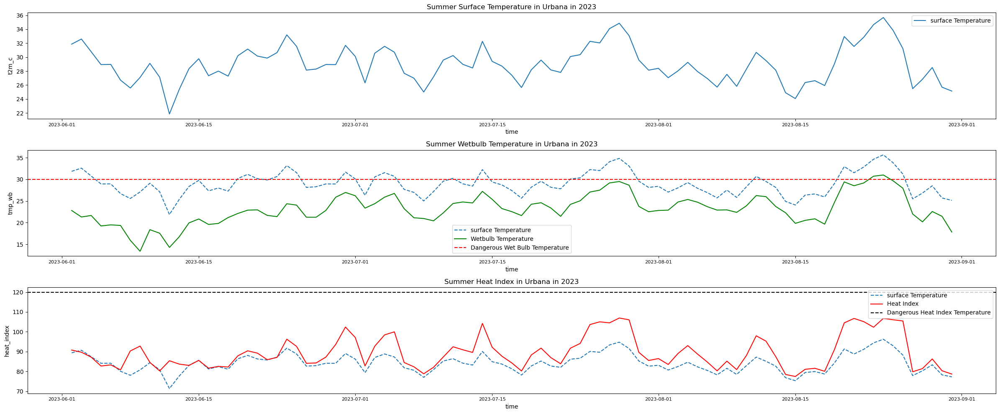

In [29]:
print("Available Year: 1940-2024")
year_ind = int(input("Enter year here: "))

plt.figure(figsize=[24,10])

# Remove 1976 and 1998 year out, data not available for some reason
if year_ind == 1976 or year_ind == 1998:
    print("Data in this year does not exist")

if year_ind > 1976:
    year_ind = year_ind - 1
if year_ind > 1998:
    year_ind = year_ind - 1

year_ind =  year_ind - 1939

if year_ind == -1:
    clock = range(0,92)
else:
    clock = range((92*(year_ind-1))+1,92*year_ind)

# Graph for 
plt.subplot(3,1,1); 

max_tmp.isel(date=clock).plot(label='surface Temperature'); 

plt.xticks(fontsize = 8); plt.legend(); plt.title(f"Summer Surface Temperature in {location_name} in {year}");

plt.subplot(3,1,2); 

max_tmp.isel(date=clock).plot(label='surface Temperature', linestyle='--');
max_wb.isel(date=clock).plot(label='Wetbulb Temperature', color='g'); 
plt.axhline(y=30, color='red', linestyle='--', label='Dangerous Wet Bulb Temperature')

plt.xticks(fontsize = 8); plt.legend(); plt.title(f"Summer Wetbulb Temperature in {location_name} in {year}");

plt.subplot(3,1,3); 

(max_tmp.isel(date=clock) * 9/5 + 32).plot(label='surface Temperature', linestyle='--');
max_hi.isel(date=clock).plot(label='Heat Index', color='r');
plt.axhline(y=120, color='black', linestyle='--', label='Dangerous Heat Index Temperature')

plt.xticks(fontsize = 8); plt.legend(); plt.title(f"Summer Heat Index in {location_name} in {year}");

plt.tight_layout();

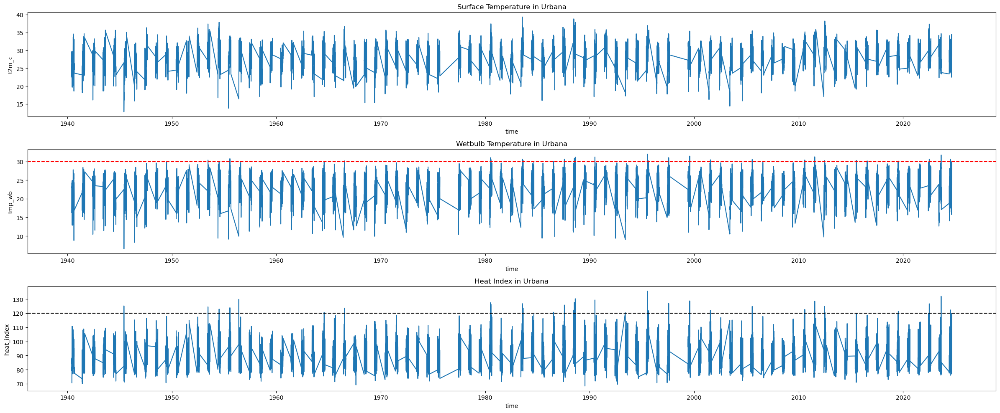

In [9]:
plt.figure(figsize=[24,10])

plt.subplot(3,1,1); max_tmp.plot(); plt.title("Surface Temperature in Urbana");
plt.subplot(3,1,2); max_wb.plot(); plt.title("Wetbulb Temperature in Urbana");
plt.axhline(y=30, color='red', linestyle='--', label='Dangerous Wet Bulb Temperature')

plt.subplot(3,1,3); max_hi.plot(); plt.title("Heat Index in Urbana");
plt.axhline(y=120, color='black', linestyle='--', label='Dangerous Heat Index Temperature')

plt.tight_layout();

### Quantile Test

In [7]:
from sklearn.linear_model import QuantileRegressor
import sklearn

In [25]:
location_ds

<xarray.Dataset> Size: 9MB
Dimensions:     (valid_time: 185472)
Coordinates:
    number      int64 8B 0
  * valid_time  (valid_time) datetime64[ns] 1MB 1940-06-01 ... 2024-08-31T23:...
    latitude    float64 8B 40.25
    longitude   float64 8B -88.25
    expver      (valid_time) <U4 3MB '0001' '0001' '0001' ... '0001' '0001'
Data variables:
    d2m         (valid_time) float32 742kB 286.0 284.9 284.3 ... 288.2 288.7
    t2m         (valid_time) float32 742kB 291.0 289.6 288.1 ... 300.1 299.6
    t2m_c       (valid_time) float32 742kB 17.82 16.44 14.93 ... 26.91 26.45
    d2m_c       (valid_time) float32 742kB 12.8 11.72 11.15 ... 15.64 15.05 15.6
    tmp_wb      (valid_time) float32 742kB 14.47 13.11 12.07 ... 20.59 20.65
    heat_index  (valid_time) float32 742kB 74.31 76.43 77.78 ... 81.86 81.25
Attributes:
    GRIB_centre:             ecmf
    GRIB_centreDescription:  European Centre for Medium-Range Weather Forecasts
    GRIB_subCentre:          0
    Conventions:             CF-1.7
    institution:             European Centre for Medium-Range Weather Forecasts
    history:                 2024-12-04T06:37 GRIB to CDM+CF via cfgrib-0.9.1...

/tmp/ipykernel_13794/4226810291.py:8: UserWarning: Converting non-nanosecond precision datetime values to nanosecond precision. This behavior can eventually be relaxed in xarray, as it is an artifact from pandas which is now beginning to support non-nanosecond precision values. This warning is caused by passing non-nanosecond np.datetime64 or np.timedelta64 values to the DataArray or Variable constructor; it can be silenced by converting the values to nanosecond precision ahead of time.
  time_numeric = ds['valid_time'].astype('datetime64[s]').astype(int)


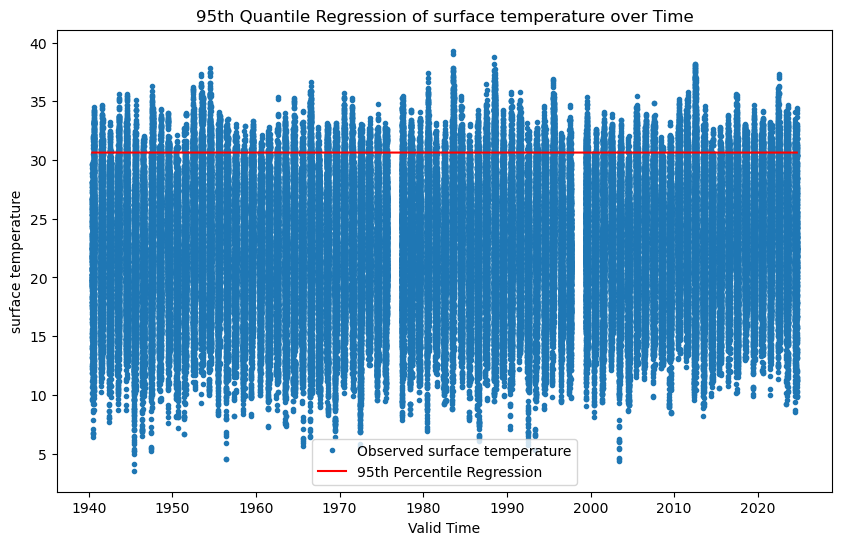

/tmp/ipykernel_13794/4226810291.py:8: UserWarning: Converting non-nanosecond precision datetime values to nanosecond precision. This behavior can eventually be relaxed in xarray, as it is an artifact from pandas which is now beginning to support non-nanosecond precision values. This warning is caused by passing non-nanosecond np.datetime64 or np.timedelta64 values to the DataArray or Variable constructor; it can be silenced by converting the values to nanosecond precision ahead of time.
  time_numeric = ds['valid_time'].astype('datetime64[s]').astype(int)


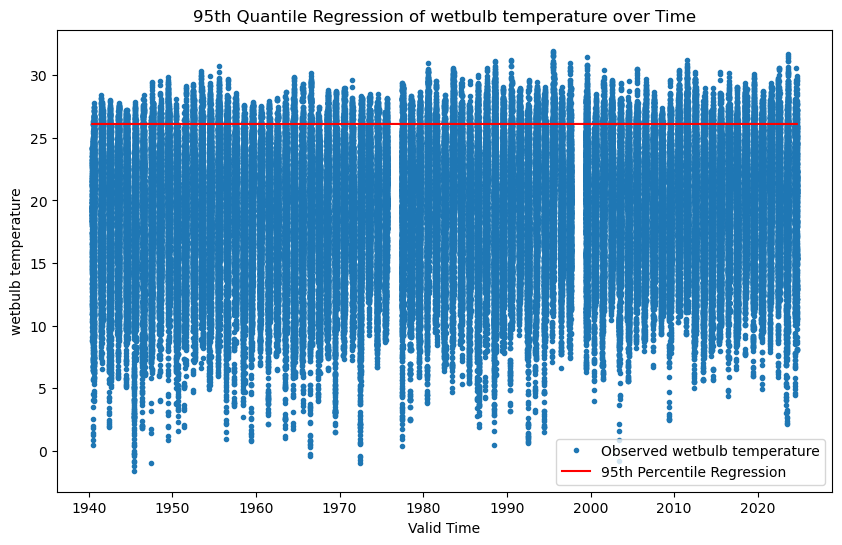

/tmp/ipykernel_13794/4226810291.py:8: UserWarning: Converting non-nanosecond precision datetime values to nanosecond precision. This behavior can eventually be relaxed in xarray, as it is an artifact from pandas which is now beginning to support non-nanosecond precision values. This warning is caused by passing non-nanosecond np.datetime64 or np.timedelta64 values to the DataArray or Variable constructor; it can be silenced by converting the values to nanosecond precision ahead of time.
  time_numeric = ds['valid_time'].astype('datetime64[s]').astype(int)


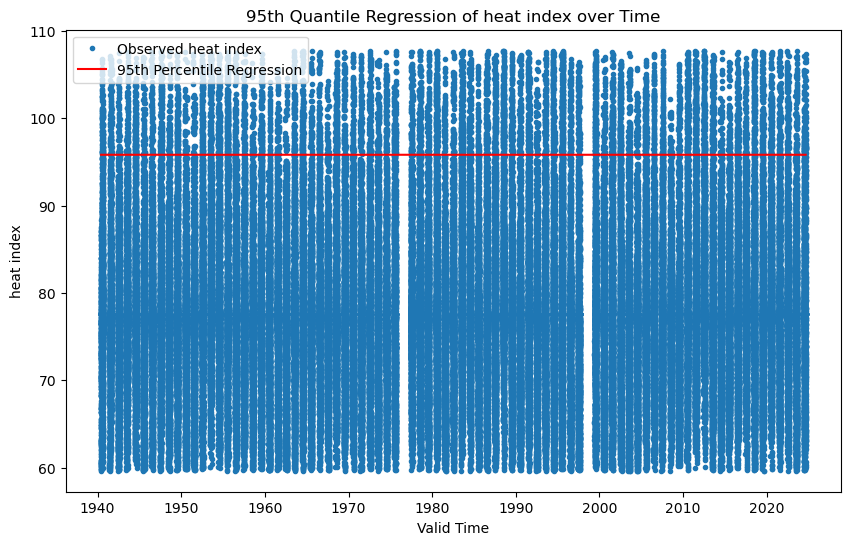

In [12]:
parameters = ['t2m_c', 'tmp_wb', 'heat_index']
names = ['surface temperature', 'wetbulb temperature', 'heat index']

for i, parameter in enumerate(parameters):
    ds = location_ds
    
    ds = ds.sortby('valid_time') 
    time_numeric = ds['valid_time'].astype('datetime64[s]').astype(int)
    
    # for y. Fill NaN values with mean values
    y = ds[parameter].fillna(ds[parameter].mean())
    y = y.values
    
    X = np.ones((y.shape[0], 1))
    
    
    qr = QuantileRegressor(quantile=0.95, alpha=0)
    qr.fit(X, y)
    
    
    y_pred = qr.predict(X)
    
    
    # ds['heat_index_95th'] = (('valid_time'), y_pred)
    
    
    plt.figure(figsize=(10, 6))
    plt.plot(ds['valid_time'].values, y, '.', label=f'Observed {names[i]}')
    plt.plot(ds['valid_time'].values, y_pred, '-', color='red', label='95th Percentile Regression')
    plt.xlabel('Valid Time')
    plt.ylabel(names[i])
    plt.legend()
    plt.title(f'95th Quantile Regression of {names[i]} over Time')
    plt.show()

In [67]:
temperature = location_ds['t2m_c'].values.flatten()
wetbulb = location_ds['tmp_wb'].values.flatten()
heat_index = location_ds['heat_index'].values.flatten()

X = np.ones((temperature.shape[0], 1))

def get_quantile (y,quantile=0.95):
    qr = QuantileRegressor(quantile=quantile,alpha=0)
    qr.fit(X, y)
    return qr.intercept_

tmp_95 = get_quantile(temperature, 0.95)
# wetbulb_95 = get_quantile(wetbulb, 0.95)
# heat_index_95 = get_quantile(heat_index, 0.95)

In [68]:
tmp_95

30.847808837890625

In [9]:
location_ds['t2m_c'].values.flatten()

array([17.815094, 16.438385, 14.92691 , ..., 28.448883, 26.91397 ,
       26.446198], dtype=float32)

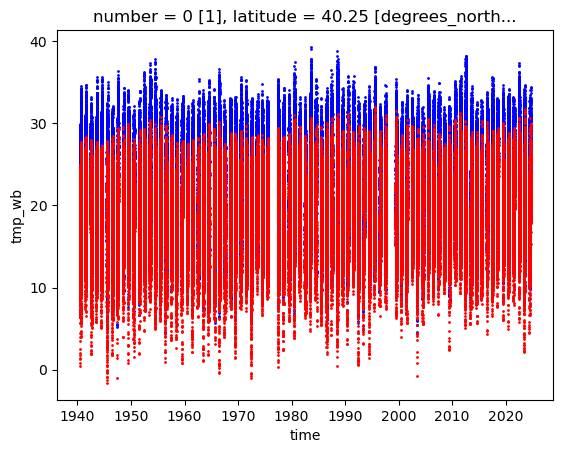

In [6]:
location_ds.plot.scatter(x="valid_time",y="t2m_c", color='b', s=1)
location_ds.plot.scatter(x="valid_time",y="tmp_wb", color='r', s=1)
#location_ds.plot.scatter(x="valid_time",y="heat_index", color='g', s=1)

In [29]:
location_ds.valid_time

<xarray.DataArray 'valid_time' (valid_time: 185472)> Size: 1MB
array(['1940-06-01T00:00:00.000000000', '1940-06-01T01:00:00.000000000',
       '1940-06-01T02:00:00.000000000', ..., '2024-08-31T21:00:00.000000000',
       '2024-08-31T22:00:00.000000000', '2024-08-31T23:00:00.000000000'],
      dtype='datetime64[ns]')
Coordinates:
    number      int64 8B 0
  * valid_time  (valid_time) datetime64[ns] 1MB 1940-06-01 ... 2024-08-31T23:...
    latitude    float64 8B 40.25
    longitude   float64 8B -88.25
    expver      (valid_time) <U4 3MB '0001' '0001' '0001' ... '0001' '0001'
Attributes:
    long_name:      time
    standard_name:  time

In [18]:
plt.scatter(location_ds['t2m_c'].values, location_ds.valid_time.values, s=0.02)

In [9]:
# Data
df = location_ds

# ------------------------------------------------------------------------------
# Fit Quantile Regression for each temperature metric
# ------------------------------------------------------------------------------
# metrics = ['t2m_c', 'tmp_wb', 'heat_index']
metrics = ['t2m_c']
results = {}

for metric in metrics:
    sub_df = df
    
    X = sub_df[metric].values
    X = X[:, np.newaxis]

    y = sub_df.valid_time.values
    

    qreg = QuantileRegressor(quantile=0.95, alpha=0.0)
    
    qreg.fit(X, y)
    
    slope = qreg.coef_[0]
    intercept = qreg.intercept_
    
    results[metric] = {
        'slope_95th': slope,
        'intercept_95th': intercept
    }


for metric, result in results.items():
    print(f"95th percentile regression for {metric}:")
    print(f"  slope: {result['slope_95th']:.4f}")
    print(f"  intercept: {result['intercept_95th']:.4f}")
    print("")


95th percentile regression for t2m_c:
  slope: 5455436308334050.0000
  intercept: 1472967949577431296.0000



In [32]:
X

array([[17.815094],
       [16.438385],
       [14.92691 ],
       ...,
       [28.448883],
       [26.91397 ],
       [26.446198]], dtype=float32)

In [12]:
rearr_X = X.T
rearr_X

array([[17.815094, 16.438385, 14.92691 , ..., 28.448883, 26.91397 ,
        26.446198]], dtype=float32)

In [40]:
y_pred = qreg.predict(X)

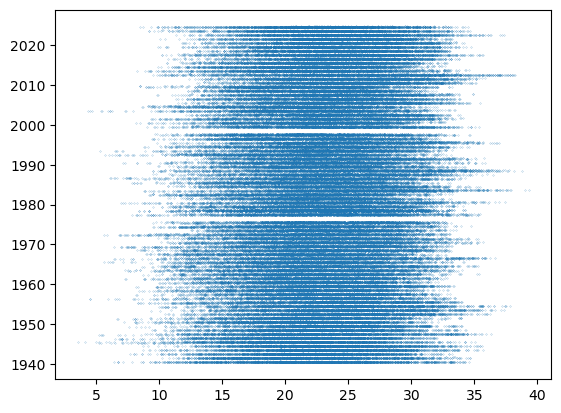

In [7]:
plt.scatter(location_ds['t2m_c'].values, location_ds.valid_time.values, s=0.02)

In [15]:


# plt.plot(X, y_pred)

# Define the slope and intercept
m = result['slope_95th']
c = result['intercept_95th']

x = np.linspace(0, 40, 10)

y = m * x + c

plt.scatter(location_ds['t2m_c'].values, location_ds.valid_time.values, s=0.02)

#plt.plot(x, y)

In [ ]:
plt.plot(X, y_true_mean, color="black", linestyle="dashed", label="True mean")

for quantile, y_pred in predictions.items():
    plt.plot(X, y_pred, label=f"Quantile: {quantile}")

plt.scatter(
    x[out_bounds_predictions],
    y_normal[out_bounds_predictions],
    color="black",
    marker="+",
    alpha=0.5,
    label="Outside interval",
)
plt.scatter(
    x[~out_bounds_predictions],
    y_normal[~out_bounds_predictions],
    color="black",
    alpha=0.5,
    label="Inside interval",
)

plt.legend()
plt.xlabel("x")
plt.ylabel("y")
_ = plt.title("Quantiles of heteroscedastic Normal distributed target")

In [ ]:
quantiles = [0.05, 0.5, 0.95]
predictions = {}
out_bounds_predictions = np.zeros_like(y_true_mean, dtype=np.bool_)
for quantile in quantiles:
    qr = QuantileRegressor(quantile=quantile, alpha=0)
    y_pred = qr.fit(X, y_normal).predict(X)
    predictions[quantile] = y_pred

    if quantile == min(quantiles):
        out_bounds_predictions = np.logical_or(
            out_bounds_predictions, y_pred >= y_normal
        )
    elif quantile == max(quantiles):
        out_bounds_predictions = np.logical_or(
            out_bounds_predictions, y_pred <= y_normal
        )

## Ignore below

Available Year: 1940-2024


Enter year here:  2020


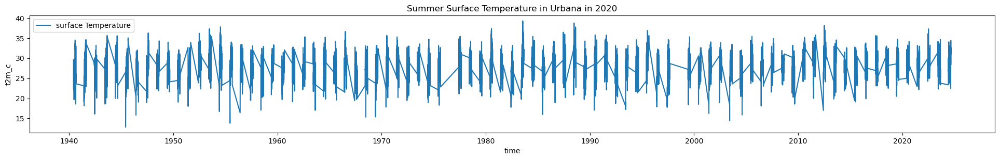

In [30]:
max_tmp = location_ds.t2m_c.groupby(location_ds.valid_time.dt.date).max()

plt.figure(figsize=[24,10])

# Set up 
print("Available Year: 1940-2024")
year = input("Enter year here: ")

# Graph for 
plt.subplot(3,1,1); 

max_tmp.sel(valid_time=year).t2m_c.plot(label='surface Temperature'); 

plt.legend(); plt.title(f"Summer Surface Temperature in Urbana in {year}");

In [11]:
# Old workflow
max_tmp, max_dpt, max_wb, max_hi = [],[],[],[]
for day in range(1, 93, 1):
    if day == 1:
        clock = range(0,24)
    else:
        clock = range((24*(day-1))+1,24*day)
    
    # max_tmp.append(location_ds.isel(valid_time=clock).t2m_c.max())
    # max_dpt = location_ds.isel(valid_time=clock).d2m_c.max()
    # max_wb = location_ds.isel(valid_time=clock).tmp_wb.max()
    # max_hi = location_ds.isel(valid_time=clock).heat_index.max()
    max_tmp.append(location_ds.isel(valid_time=clock).t2m_c.max().values)
max_tmp

[array(22.53701782),
 array(25.32510376),
 array(26.41104126),
 array(26.81069946),
 array(28.14151001),
 array(29.65200806),
 array(28.16885376),
 array(26.6991272),
 array(27.89712524),
 array(26.43545532),
 array(22.40322876),
 array(26.26577759),
 array(23.01187134),
 array(24.33511353),
 array(27.2484436),
 array(27.29116821),
 array(27.13223267),
 array(27.66104126),
 array(24.32705688),
 array(19.59024048),
 array(19.66275024),
 array(27.18887329),
 array(28.74038696),
 array(23.45596313),
 array(21.97915649),
 array(24.86636353),
 array(26.4960022),
 array(27.47549438),
 array(21.32803345),
 array(25.12637329),
 array(23.46450806),
 array(19.87319946),
 array(20.89517212),
 array(22.02798462),
 array(24.32192993),
 array(25.59951782),
 array(26.55484009),
 array(27.53604126),
 array(27.5218811),
 array(28.67349243),
 array(29.13345337),
 array(21.43984985),
 array(20.06387329),
 array(23.81607056),
 array(26.88027954),
 array(22.95791626),
 array(23.46035767),
 array(26.4779357

In [15]:
daily_max = location_ds.groupby(location_ds.coords['valid_time'].dt.floor("D")).max()

plt.figure(figsize=[24,10])

# Set up 
print("Available Year: 1940-2024")
year = input("Enter year here: ")

# Graph for 
plt.subplot(3,1,1); 

daily_max.t2m_c.plot(label='surface Temperature'); 
daily_max.d2m_c.plot(label='surface dewpoint Temperature'); 

plt.legend(); plt.title(f"Summer Surface Temperature in Urbana in {year}");

ValueError: index must be monotonic for resampling

In [6]:
ds_tmp

<xarray.Dataset> Size: 876kB
Dimensions:     (valid_time: 15640, latitude: 2, longitude: 2)
Coordinates:
    number      int64 8B ...
  * valid_time  (valid_time) datetime64[ns] 125kB 1940-06-01T09:00:00 ... 202...
  * latitude    (latitude) float64 16B 40.25 40.0
  * longitude   (longitude) float64 16B -88.25 -88.0
    expver      (valid_time) <U4 250kB ...
Data variables:
    d2m         (valid_time, latitude, longitude) float32 250kB ...
    t2m         (valid_time, latitude, longitude) float32 250kB 283.3 ... 302.0
Attributes:
    GRIB_centre:             ecmf
    GRIB_centreDescription:  European Centre for Medium-Range Weather Forecasts
    GRIB_subCentre:          0
    Conventions:             CF-1.7
    institution:             European Centre for Medium-Range Weather Forecasts
    history:                 2024-12-03T00:12 GRIB to CDM+CF via cfgrib-0.9.1...

In [10]:
ds_tmp = ds_tmp.assign(t2m_c = ds_tmp.t2m - 273.15)

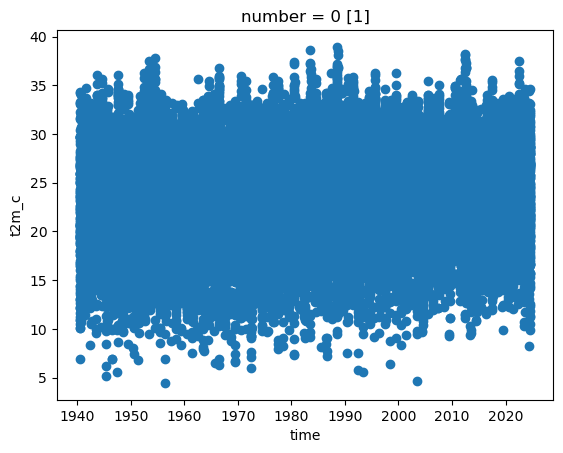

In [20]:
ds_tmp.t2m_c.mean(dim=["latitude", "longitude"]).plot(marker="o",linestyle='')

In [21]:
ds_flux

<xarray.Dataset> Size: 1MB
Dimensions:     (valid_time: 15640, latitude: 2, longitude: 2)
Coordinates:
    number      int64 8B ...
  * valid_time  (valid_time) datetime64[ns] 125kB 1940-06-01T09:00:00 ... 202...
  * latitude    (latitude) float64 16B 40.25 40.0
  * longitude   (longitude) float64 16B -88.25 -88.0
    expver      (valid_time) <U4 250kB ...
Data variables:
    ssr         (valid_time, latitude, longitude) float32 250kB ...
    str         (valid_time, latitude, longitude) float32 250kB ...
    tsr         (valid_time, latitude, longitude) float32 250kB ...
    ttr         (valid_time, latitude, longitude) float32 250kB ...
Attributes:
    GRIB_centre:             ecmf
    GRIB_centreDescription:  European Centre for Medium-Range Weather Forecasts
    GRIB_subCentre:          0
    Conventions:             CF-1.7
    institution:             European Centre for Medium-Range Weather Forecasts
    history:                 2024-12-03T00:12 GRIB to CDM+CF via cfgrib-0.9.1...

In [22]:
ds_flux = ds_flux.assign(toa = ds_flux.tsr - ds_flux.ttr)
ds_flux = ds_flux.assign(tas = ds_flux.ssr - ds_flux.str)